## Component

1.[Data Processing For Machine Learning](#1-Data-Processing-for-Machine-Learning)
  
2.[Feature Engineering](#2-Feature-Engineering)

3.[Feature Selection and Dimentionality Reduction](#3-Feature-Selection-and-Dimensionality-Reduction)
   
4.[Model Building](#4-Model-Building)

   4.1 [A Linear Model](#4.1-A-Linear-Model)
   
   4.2 [A Random Forest](#4.2-A-Random-Forest)
   
   4.3 [A Boosted Tree](#4.3-A-Boosted-Tree)   
   
   4.4 [An Averager / Voter / Stacker Ensemble](#4.3-An-Averager-Voter-Stacker-Ensemble)
   
5.[Model Evaluation and Analysis](#4-Model-Evaluation-and-Analysis)

   5.1 [Overall Performance with Cross-Validation](#4.1-Overall-Performance-with-cross-validation)
   
   5.2 [True vs Predicted Analysis](#4.2-True-vs-Predicted-Analysis)
   
   5.3 [Global and Local Explanations with SHAP](#4.3-Global-and-Local-Explanations-with-SHAP)   
   
   5.4 [Partial Dependancy Plots](#4.3-Partial-Dependancy-Plots)







In [1]:
!pip install -q shap
import shap
shap.initjs()

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.6/572.6 kB 5.3 MB/s eta 0:00:00


In [2]:
  import pandas as pd
  import numpy as np
  import matplotlib.pyplot as plt
  import seaborn as sns
  sns.set(
      { "figure.figsize": (6, 4) },
          style='ticks',
          color_codes=True,
          font_scale=0.8
      )
  %config InlineBackend.figure_formats = set(('retina', 'svg'))

In [3]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.ensemble import VotingRegressor

In [4]:
from sklearn.model_selection import GridSearchCV, ParameterGrid
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error
from functools import partial
rmse = partial(mean_squared_error, squared=False)

In [5]:
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures

In [6]:
##import the necessory libraries from sklearn.linear model import LinearRegression and model
from sklearn.linear_model import LinearRegression , Lasso
from sklearn import metrics
#importing mean absolute error
from sklearn.metrics import mean_absolute_error
from sklearn.compose import ColumnTransformer

# 1.[Data Processing For Machine Learning](#1-Data-Processing-for-Machine-Learning)

In [7]:
adverts = pd.read_csv('adverts.csv')

In [10]:
adverts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 402005 entries, 0 to 402004
Data columns (total 12 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   public_reference       402005 non-null  int64  
 1   mileage                401878 non-null  float64
 2   reg_code               370148 non-null  object 
 3   standard_colour        396627 non-null  object 
 4   standard_make          402005 non-null  object 
 5   standard_model         402005 non-null  object 
 6   vehicle_condition      402005 non-null  object 
 7   year_of_registration   368694 non-null  float64
 8   price                  402005 non-null  int64  
 9   body_type              401168 non-null  object 
 10  crossover_car_and_van  402005 non-null  bool   
 11  fuel_type              401404 non-null  object 
dtypes: bool(1), float64(2), int64(2), object(7)
memory usage: 34.1+ MB


In [11]:
adv = adverts.sample(n=20000, replace=True, ignore_index=True, random_state=5)

### Analysis of Distributions

In [12]:
adv['price'].value_counts()

8995     151
6995     131
9995     117
4995     116
7995     108
        ... 
50778      1
14780      1
71516      1
9145       1
12754      1
Name: price, Length: 5274, dtype: int64

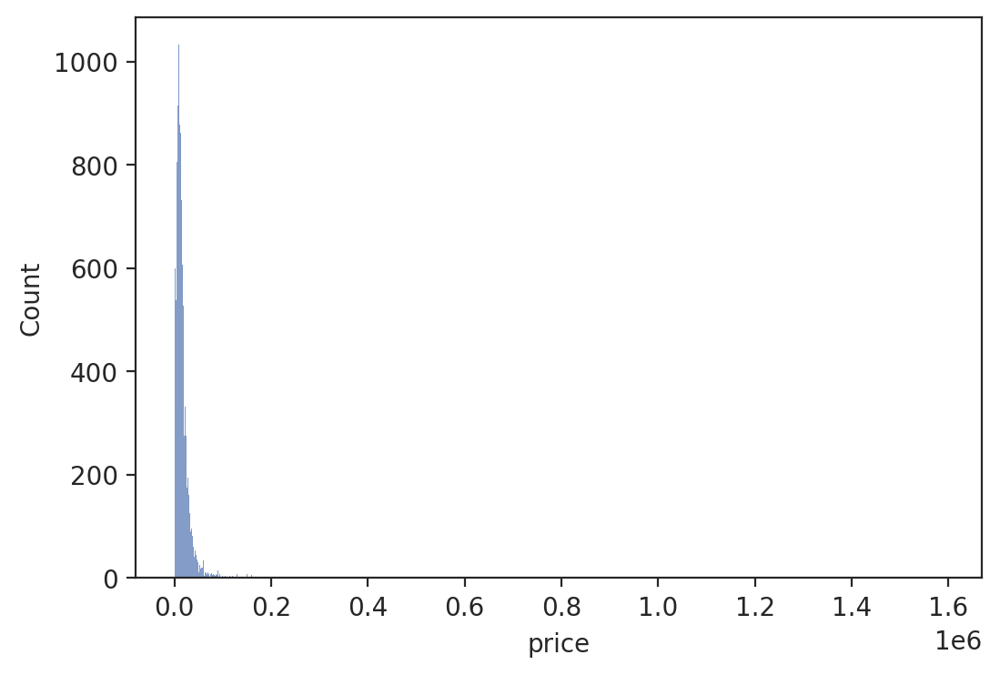

In [13]:
sns.histplot(x=adv.loc[adv['price']>0, 'price']);

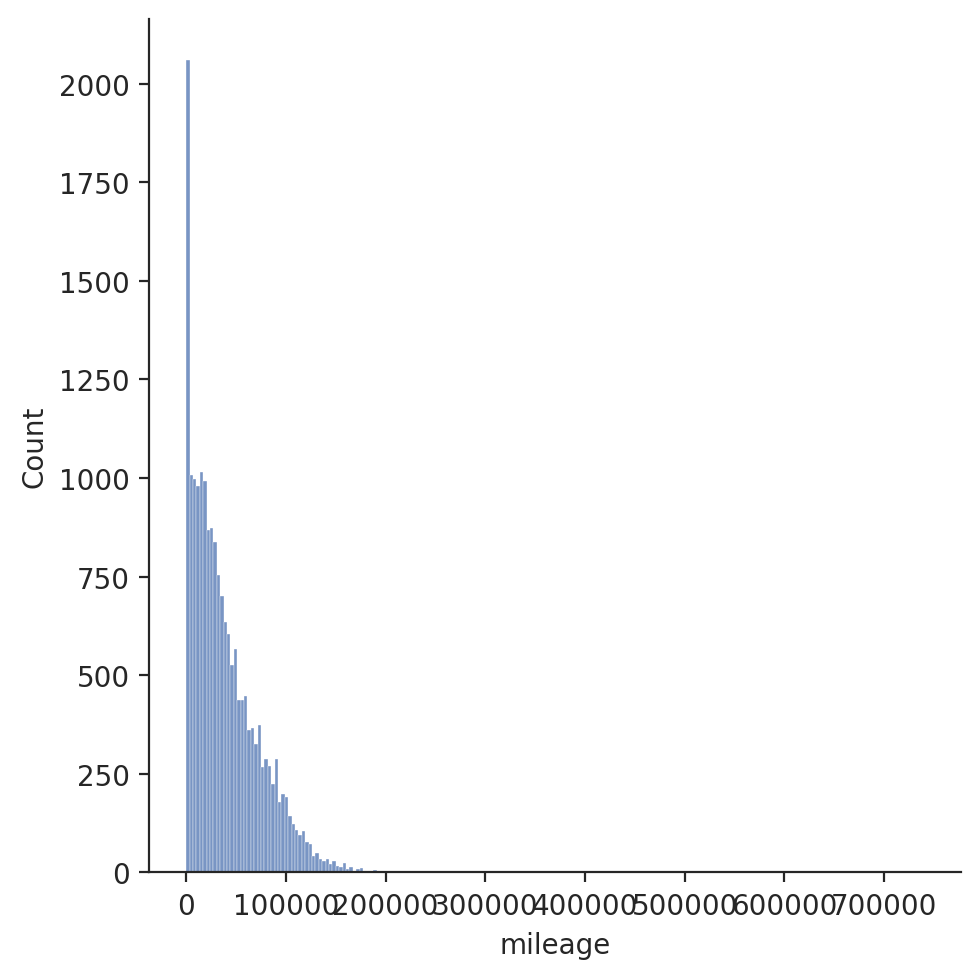

In [14]:
sns.displot(x=adv.loc[adv['mileage']>0, 'mileage']);

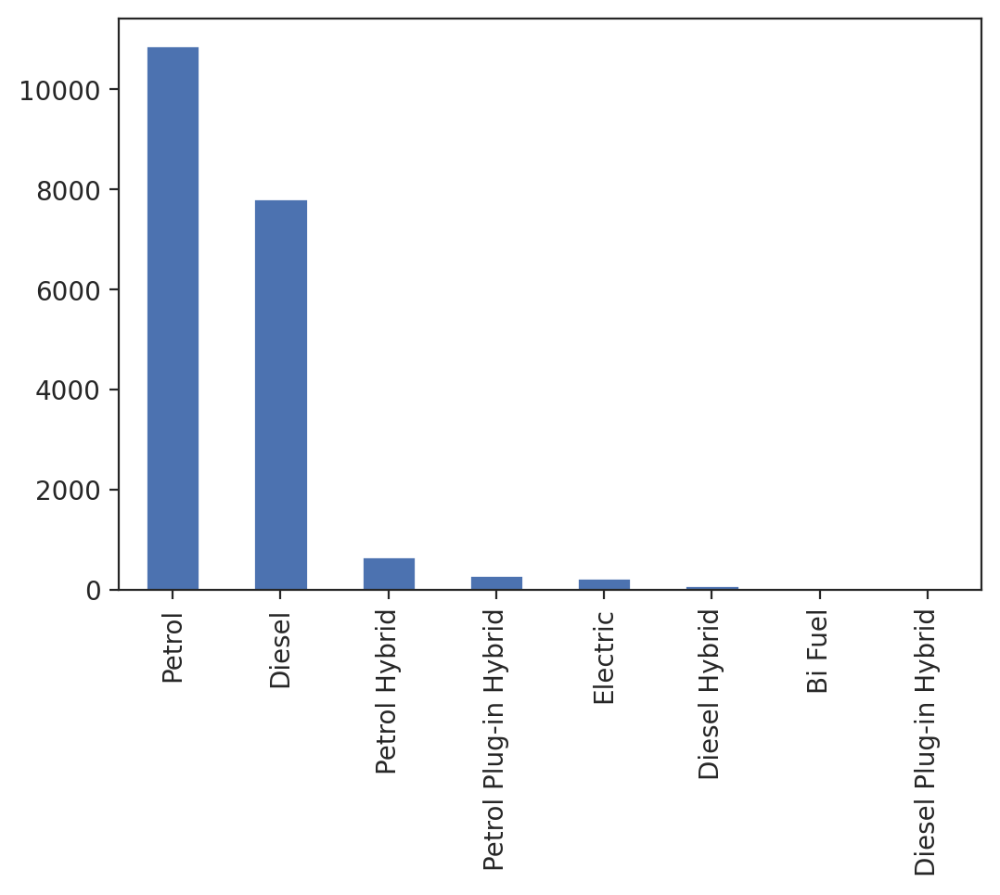

In [15]:
adv['fuel_type'].value_counts().plot.bar();

### Identification of missing values

In [16]:
# for finding the null values in the dataset
adv.isnull().sum()

public_reference            0
mileage                     9
reg_code                 1539
standard_colour           250
standard_make               0
standard_model              0
vehicle_condition           0
year_of_registration     1619
price                       0
body_type                  43
crossover_car_and_van       0
fuel_type                  40
dtype: int64

It identifies the missing values in each column and the total number of missing values.

### Identification and Dealing of outliers and noise



In this part, I will use price, mileage, and registration year to identify outliers and noise. According to my knowledge, these are the key factors for predicting car sales prices.

First, I will replace missing standard color, body type, and fuel type data with mode method

In [17]:
mode_color = adv['standard_colour'].mode()[0]
adv['standard_colour'].fillna(mode_color, inplace = True)

In [18]:
mode_body_type = adv['body_type'].mode()[0]
adv['body_type'].fillna(mode_body_type, inplace = True)

In [19]:
mode_fuel_type = adv['fuel_type'].mode()[0]
adv['fuel_type'].fillna(mode_fuel_type, inplace = True)

In [20]:
adv['mileage'].median()

29000.0

In [21]:
adv['mileage'] = adv['mileage'].fillna(adv['mileage'].median())

The above columns missing values filled with mode(value appears most frequently in data set)

In [22]:
# for finding the null values in the dataset
adv.isnull().sum()

public_reference            0
mileage                     0
reg_code                 1539
standard_colour             0
standard_make               0
standard_model              0
vehicle_condition           0
year_of_registration     1619
price                       0
body_type                   0
crossover_car_and_van       0
fuel_type                   0
dtype: int64

Still reg code and year of registration have missing values

In [23]:
adv.loc[(adv['mileage'] <= 25) & (adv['year_of_registration'].isnull()) & (adv['vehicle_condition'] == "NEW") , 'year_of_registration'] = 2021.0

In [24]:
adv.loc[adv['year_of_registration']== 2021.0, 'reg_code'] = 21

The registration codes for March through August of 2021 will be 21 or 71. Either or may be utilised. Presently, I am using 21 to fill missing data

In [25]:
adv.isnull().sum()

public_reference           0
mileage                    0
reg_code                  47
standard_colour            0
standard_make              0
standard_model             0
vehicle_condition          0
year_of_registration     127
price                      0
body_type                  0
crossover_car_and_van      0
fuel_type                  0
dtype: int64

In [26]:
adv[['reg_code', 'year_of_registration', 'mileage']].sample()

,reg_code,year_of_registration,mileage
4984,19,2019.0,11230.0


In [27]:
adv[adv['year_of_registration'].isna()].sample()

,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
790,202010215247701,9748.0,NaN,White,Smart,fortwo,USED,NaN,6495,Convertible,False,Petrol


In [28]:
adv[adv['reg_code'].isna()].sample()

,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
18026,202009023203252,50.0,NaN,White,Mazda,Mazda3,NEW,NaN,23690,Hatchback,False,Petrol


In [29]:
adv.dropna(inplace=True)

In [30]:
adv.isnull().sum()

public_reference         0
mileage                  0
reg_code                 0
standard_colour          0
standard_make            0
standard_model           0
vehicle_condition        0
year_of_registration     0
price                    0
body_type                0
crossover_car_and_van    0
fuel_type                0
dtype: int64

In [31]:
adv.shape

(19861, 12)

All the Nan and missing values are cleared

### Dealing with Outliers and Noise

#### Removing outliers from `Price`

<Axes: >

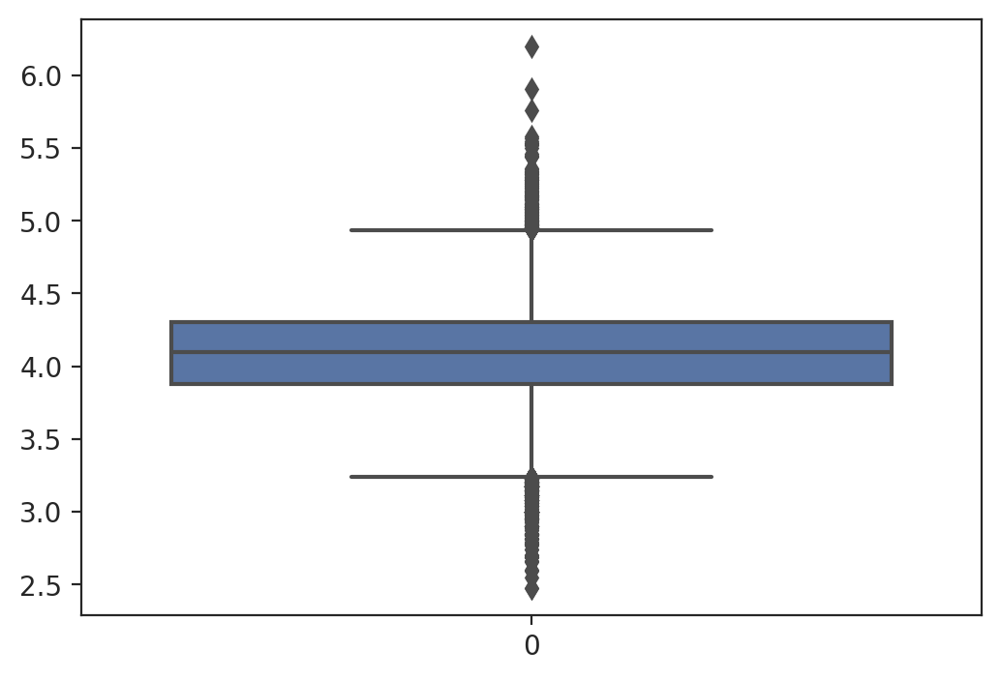

In [32]:
sns.boxplot(np.log10(adv['price']))

To eliminate price outliers, I will apply interquartile range.

In [33]:
Q3 = np.quantile(adv['price'], 0.75)
Q1 = np.quantile(adv['price'], 0.25)
IQR = Q3 - Q1
IQR

12455.0

In [34]:
lower_range = Q1 - 1.5 * IQR
upper_range = Q3 + 1.5 * IQR
outlier_free_list = [x for x in adv['price'] if ( (x > lower_range) & (x < upper_range))]
adv = adv.loc[adv['price'].isin(outlier_free_list)]

<Axes: >

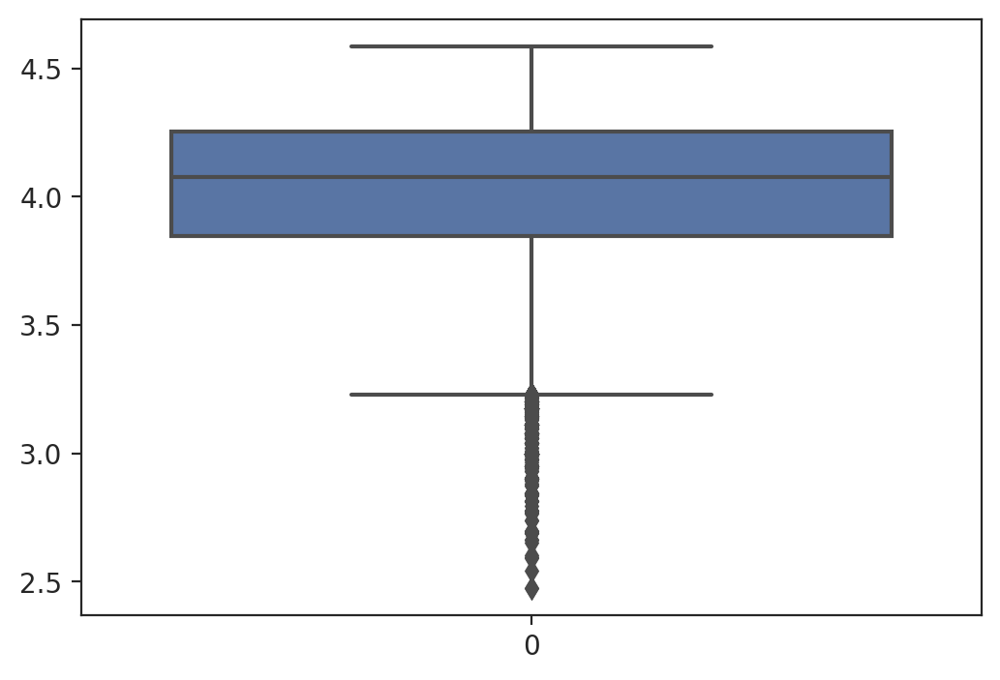

In [35]:
sns.boxplot(np.log10(adv['price']))

#### Removing outliers from `Mileage`

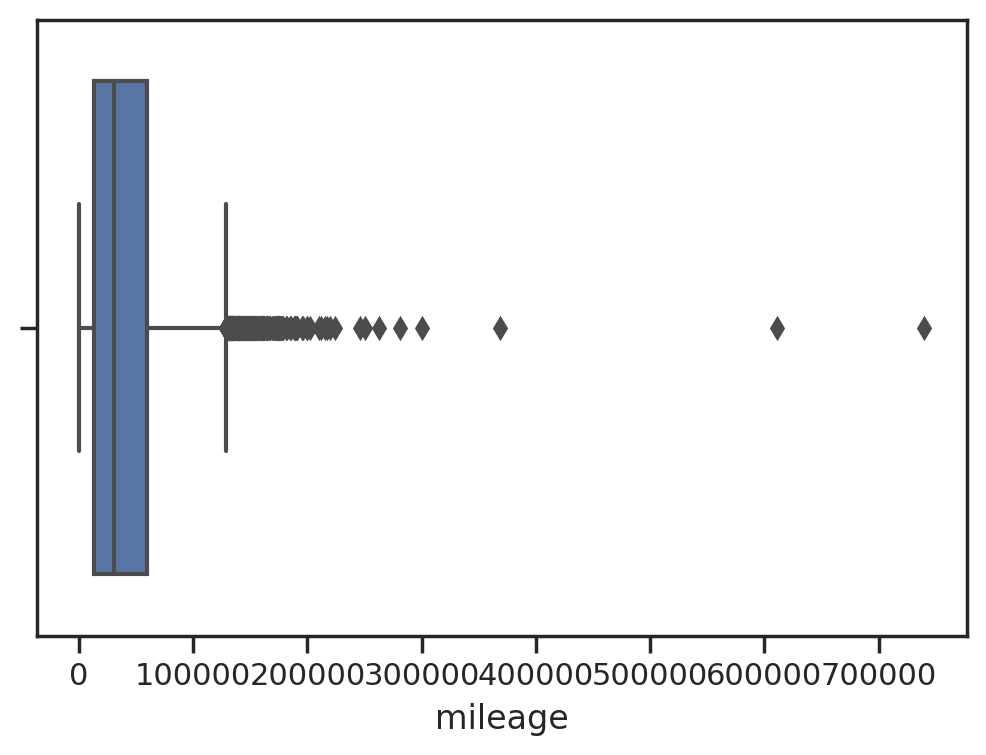

In [36]:
sns.set(style='ticks', color_codes=True)
sns.boxplot(data=adv, x='mileage')
plt.show()

In [37]:
mileage_Q3 = np.quantile(adv['mileage'], 0.75)
mileage_Q1 = np.quantile(adv['mileage'], 0.25)
mileage_IQR = mileage_Q3 - mileage_Q1
mileage_IQR

46352.25

In [38]:
mileage_lower_range = mileage_Q1 - 1.5 * mileage_IQR
mileage_upper_range = mileage_Q3 + 1.5 * mileage_IQR
mileage_outlier_free_list = [x for x in adv['mileage'] if ( (x > mileage_lower_range) & (x < mileage_upper_range))]
adv = adv.loc[adv['mileage'].isin(mileage_outlier_free_list)]

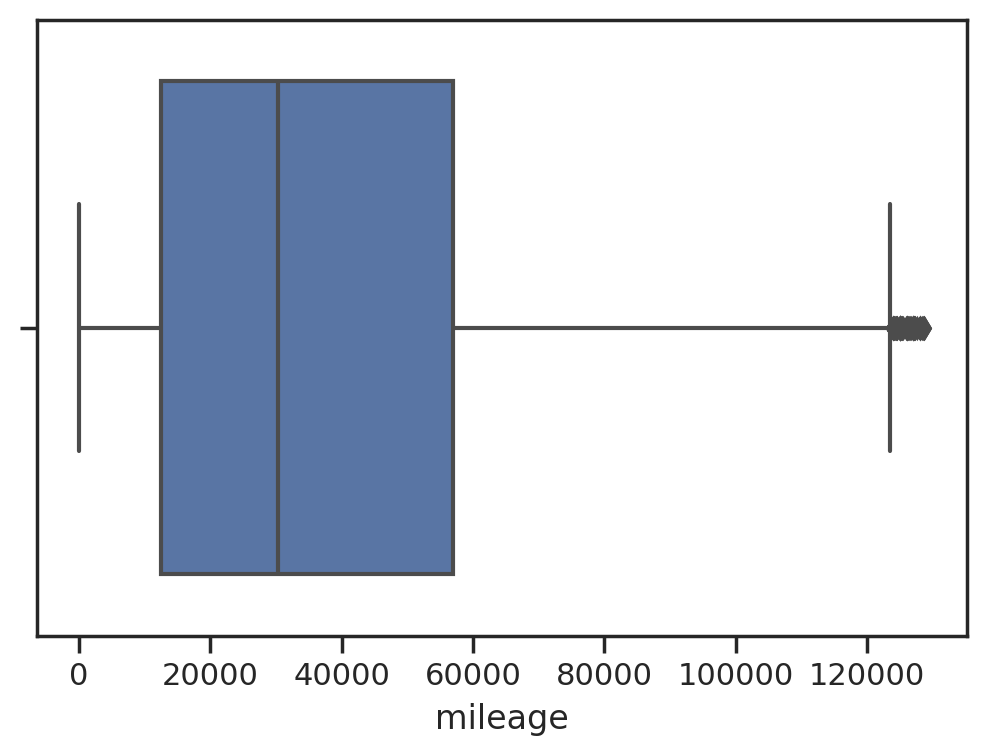

In [39]:
sns.set(style='ticks', color_codes=True)
sns.boxplot(data=adv, x='mileage')
plt.show()

#### Dealing Noise

Found one issue with the vehicle's condition. When the condition status of a car is USED, both the mileage and registration year are 0. It is incorrect because when the mileage is 0, the car should be brand-new and its condition should be NEW, and the registration year should be the current year.

In [40]:
adv.loc[(adv['vehicle_condition'] == 'USED') & (adv['year_of_registration'].isnull()) & (adv['mileage'] == 0) , 'year_of_registration'] = 2021.0

In [41]:
adv.loc[(adv['vehicle_condition'] == 'USED') & (adv['year_of_registration'] == 2021.0) & (adv['mileage'] == 0) , 'vehicle_condition'] = 'NEW'

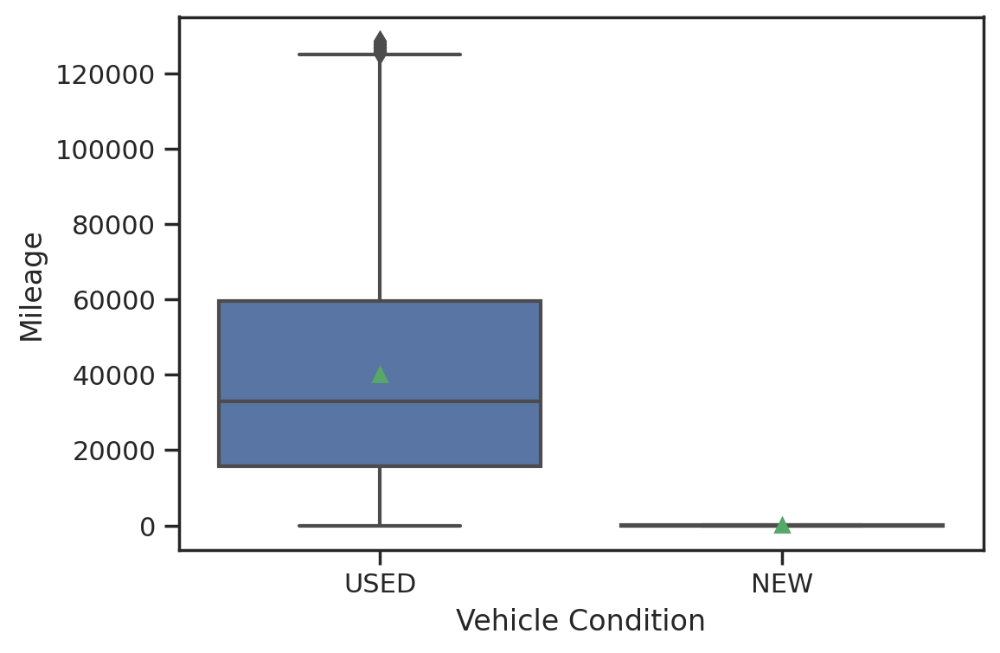

In [42]:
adv_plot = sns.boxplot(x='vehicle_condition', y='mileage', showmeans=True, data=adv)
adv_plot.set_ylabel('Mileage')
adv_plot.set_xlabel('Vehicle Condition');

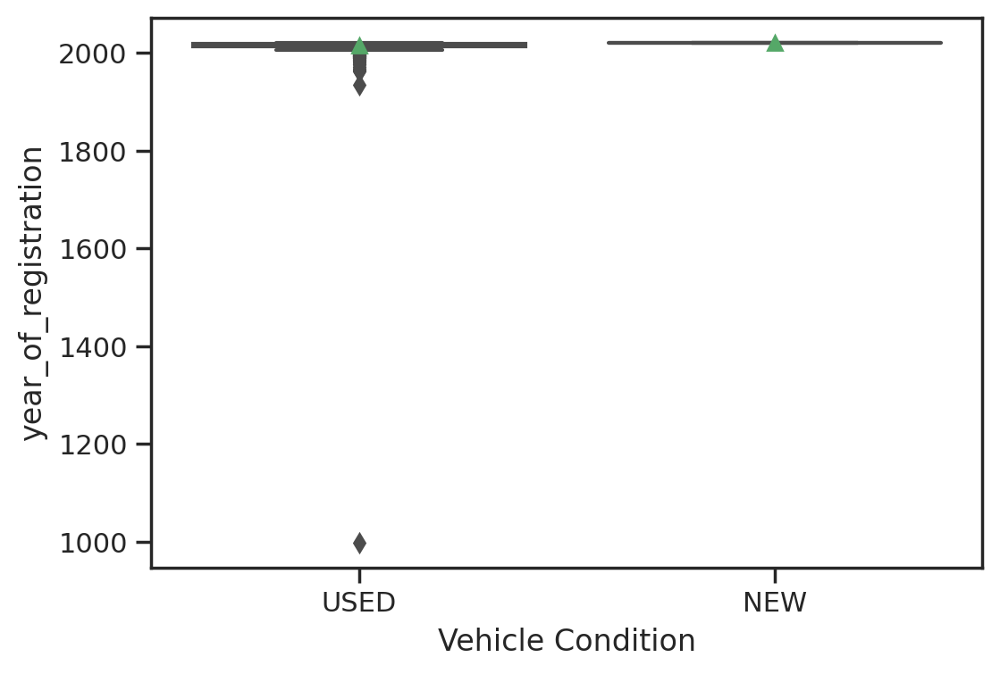

In [43]:
adv_plot = sns.boxplot(x='vehicle_condition', y='year_of_registration', showmeans=True, data=adv)
adv_plot.set_ylabel('year_of_registration')
adv_plot.set_xlabel('Vehicle Condition');

In [44]:
adv = adv[adv['year_of_registration'].notnull()]

In [45]:
adv.isnull().sum()

public_reference         0
mileage                  0
reg_code                 0
standard_colour          0
standard_make            0
standard_model           0
vehicle_condition        0
year_of_registration     0
price                    0
body_type                0
crossover_car_and_van    0
fuel_type                0
dtype: int64

### Categorical Encoding

#### with OrdinalEncoder

Utilizing ordinalEncoder to convert all categorical variables to numeric values. Converting standard_make, standard_colour,standard_model, body_type and fuel_type

In [46]:
#importing ordinalEncoder
from sklearn.preprocessing import OrdinalEncoder

In [47]:
adv.sample()

,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
15463,202009183910796,753.0,20,Grey,Jeep,Renegade,USED,2020.0,20490,SUV,False,Petrol


#### Encoding `standard_make`

In [48]:
#initializing ordinalEncoder
sm_oe = OrdinalEncoder()
sm_oe.fit(adv[['standard_make']])

OrdinalEncoder()

Each label is converted to an integer value, and the encoded data represents the label sequence.

In [49]:
sm_oe.categories_

[array(['Abarth', 'Alfa Romeo', 'Aston Martin', 'Audi', 'Austin', 'BMW',
        'Bentley', 'CUPRA', 'Cadillac', 'Chevrolet', 'Chrysler', 'Citroen',
        'DS AUTOMOBILES', 'Dacia', 'Daihatsu', 'Dodge', 'Fiat', 'GMC',
        'Great Wall', 'Holden', 'Honda', 'Hyundai', 'Infiniti', 'Isuzu',
        'Jaguar', 'Jeep', 'Kia', 'LEVC', 'Land Rover', 'Lexus', 'Lotus',
        'MG', 'MINI', 'Maserati', 'Mazda', 'Mercedes-Benz', 'Mitsubishi',
        'Morris', 'Nissan', 'Perodua', 'Peugeot', 'Porsche', 'Proton',
        'Renault', 'Rover', 'SEAT', 'SKODA', 'Saab', 'Smart', 'SsangYong',
        'Subaru', 'Suzuki', 'TVR', 'Tesla', 'Toyota', 'Vauxhall',
        'Volkswagen', 'Volvo'], dtype=object)]

In [50]:
adv[['standard_make']] = sm_oe.transform(adv[['standard_make']])

standard make changed to numerical values

#### Encoding `body_type`

In [51]:
#initializing ordinalEncoder
bt_oe = OrdinalEncoder()
bt_oe.fit(adv[['body_type']])

OrdinalEncoder()

In [52]:
bt_oe.categories_

[array(['Camper', 'Combi Van', 'Convertible', 'Coupe', 'Estate',
        'Hatchback', 'Limousine', 'MPV', 'Minibus', 'Panel Van', 'Pickup',
        'SUV', 'Saloon', 'Window Van'], dtype=object)]

In [53]:
adv[['body_type']] = bt_oe.transform(adv[['body_type']])

#### Encoding `fuel_type`

In [54]:
#initializing ordinalEncoder
ft_oe = OrdinalEncoder()
ft_oe.fit(adv[['fuel_type']])

OrdinalEncoder()

In [55]:
ft_oe.categories_

[array(['Bi Fuel', 'Diesel', 'Diesel Hybrid', 'Diesel Plug-in Hybrid',
        'Electric', 'Petrol', 'Petrol Hybrid', 'Petrol Plug-in Hybrid'],
       dtype=object)]

In [56]:
adv[['fuel_type']] = ft_oe.transform(adv[['fuel_type']])

#### Encoding `standard_model`

In [57]:
#initializing ordinalEncoder
sm_oe = OrdinalEncoder()
sm_oe.fit(adv[['standard_model']])

OrdinalEncoder()

In [58]:
sm_oe.categories_

[array(['1 Series', '10', '1007', '106', '107', '108', '110', '124 Spider',
        '147', '159', '159 Sportwagon', '190', '2 Series',
        '2 Series Active Tourer', '2 Series Gran Coupe',
        '2 Series Gran Tourer', '200', '2008', '206', '206 CC', '207',
        '207 CC', '207 SW', '208', '230', '3 Series',
        '3 Series Gran Turismo', '3008', '300C', '306', '307', '307 CC',
        '307 SW', '308', '308 CC', '308 SW', '320', '350 Z', '370 Z',
        '4 Series', '4 Series Gran Coupe', '407', '45', '4C', '5 Series',
        '5 Series Gran Turismo', '500', '5008', '500C', '500L', '500X',
        '508', '508 SW', '595', '595C', '6 Series', '6 Series Gran Coupe',
        '6 Series Gran Turismo', '7 Series', '718 Boxster', '718 Cayman',
        '850', '9-3', '9-5', '90', '911', '928', '944', '968', 'A Class',
        'A1', 'A2', 'A3', 'A3 Cabriolet', 'A4', 'A4 Allroad', 'A4 Avant',
        'A4 Cabriolet', 'A5', 'A5 Cabriolet', 'A6 Allroad', 'A6 Avant',
        'A6 Saloon', 'A6 

In [59]:
adv[['standard_model']] = sm_oe.transform(adv[['standard_model']])

#### Encoding `standard_colour`

In [60]:
#initializing ordinalEncoder
sc_oe = OrdinalEncoder()
sc_oe.fit(adv[['standard_colour']])

OrdinalEncoder()

In [61]:
# #listing all categories in standard color
sc_oe.categories

'auto'

In [62]:
adv[['standard_colour']] = sc_oe.transform(adv[['standard_colour']])

In [63]:
adv['vehicle_condition'].replace({'USED':0,'NEW': 1}, inplace =True)

The values of all strings are converted to numbers. Only numerical values may be understood by machines. We converted all the string values to numerical numbers for this reason.

In [64]:
adv.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18284 entries, 0 to 19999
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   public_reference       18284 non-null  int64  
 1   mileage                18284 non-null  float64
 2   reg_code               18284 non-null  object 
 3   standard_colour        18284 non-null  float64
 4   standard_make          18284 non-null  float64
 5   standard_model         18284 non-null  float64
 6   vehicle_condition      18284 non-null  int64  
 7   year_of_registration   18284 non-null  float64
 8   price                  18284 non-null  int64  
 9   body_type              18284 non-null  float64
 10  crossover_car_and_van  18284 non-null  bool   
 11  fuel_type              18284 non-null  float64
dtypes: bool(1), float64(7), int64(3), object(1)
memory usage: 1.7+ MB


### Rescale data

To make sure that various features have a comparable scale, rescaling is frequently necessary. There are several standard methods for scaling: 

The data are scaled to a specified range, often between 0 and 1, using the Min-Max Scaling (Normalization) method. 


Data are transformed to have a zero mean and a single variance through standardization.

Here I am using MinaMaxScaler for scaling selected features

MinMaxScaler preserves the shape of the original distribution. It doesn’t meaningfully change the information embedded in the original data.

### Splitting Data into Predictors and Target

Splitting the dataset into predictors (features) and the target variable (variable to be predicted) is essential when training a machine learning model. Typically, the target is denoted by the output variable (y), whereas the predictors are denoted by the input variables (X). 

The desired result is price. So features are separated into X and Y categories. price in the Y variable and others in the x variable.

It is usual practise to divide the data into three sets: training set, validation set, and test set—in order to assess the effectiveness of the machine learning model.

Used to train the model is the training set. 

Validation Set: Used during development to fine-tune the model's hyperparameters and assess how well it performs. 

Test Set: This collection of data is used to evaluate the model's performance in its final form. 

the division of data into folds, such as with the k-fold, Hold-out cross-validation etc. Here I am using Hold-out cross-validation.

Importing the new method train_test_split to divide the data frame into the four categories of X_train, X_test, y_train, and y_test

In [65]:
X = adv.drop(columns='price')
y = adv['price']

In [66]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)
X_train.shape, y_train.shape

((13713, 11), (13713,))

# 2.[Feature Engineering](#2-Feature-Engineering) 

The creation of new features or the transformation of existing ones to enhance the performance of a model is known as feature engineering, and it is a crucial stage in the machine learning process. Deriving meaningful features from raw data frequently calls for both ingenuity and domain expertise. Here are some typical methods for feature engineering, including features derived from domain knowledge, polynomial/basis functions, and interaction features.

#### Polynomial/Basis Functions and Domain Knowledge-Based Features 

Build features that capture relevant information using domain-specific insights or expert knowledge.

By multiplying or exponentiating previously existing features, polynomial features involve the creation of new features.

Introducing new feature based on current year and year of registration, ie. `Age` of vehicle

In [67]:
adv['Current_Year']=2023
adv['year_of_registration'] = adv['year_of_registration'].astype(int)
adv['age'] = adv['Current_Year']-adv['year_of_registration']

After integrating a new feature, I will remove the year of registration and the current year and some other features from data set.

In [68]:
adv = adv.drop(columns=['public_reference','year_of_registration','Current_Year','reg_code', 'crossover_car_and_van'])

### The Scikit-Learn Way for Generating Interaction Features


Scikit-learn's preprocessing tools and feature engineering methods can be used to produce interaction features.

In [69]:
X = adv.drop(columns='price')
y = adv['price']
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)
X_train.shape, y_train.shape

((13713, 8), (13713,))

In [70]:
X_train.head()

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,body_type,fuel_type,age
14223,39174.0,1.0,55.0,111.0,0,2.0,5.0,13
4518,0.0,1.0,43.0,179.0,1,5.0,1.0,2
10252,86000.0,14.0,38.0,296.0,0,11.0,1.0,12
9138,36475.0,17.0,56.0,391.0,0,5.0,5.0,8
14532,21800.0,1.0,5.0,40.0,0,12.0,1.0,6


A PolynomialFeatures transformer instance should be created.

In [71]:
preprocessing_pipe = Pipeline(
    steps=[
        ('scaler', StandardScaler()),
        ('poly', PolynomialFeatures(interaction_only=True, include_bias=False))
    ]
).set_output(transform='pandas')

The polynomial transformer is used to fit and change the data.

In [72]:
preprocessing_pipe.fit_transform(X_train).head()

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,body_type,fuel_type,age,mileage standard_colour,mileage standard_make,...,standard_model vehicle_condition,standard_model body_type,standard_model fuel_type,standard_model age,vehicle_condition body_type,vehicle_condition fuel_type,vehicle_condition age,body_type fuel_type,body_type age,fuel_type age
14223,0.056968,-1.207174,1.176505,-0.889372,-0.258189,-1.560455,0.755056,0.554959,-0.068770,0.067023,...,0.229626,1.387825,-0.671526,-0.493565,0.402892,-0.194947,-0.143284,-1.178231,-0.865988,0.419025
4518,-1.209583,-1.207174,0.531955,-0.499910,3.873134,-0.632908,-1.242934,-0.578885,1.460177,-0.643444,...,-1.936219,0.316397,0.621356,0.289390,-2.451336,-4.814051,-2.242097,0.786663,0.366380,0.719515
10252,1.570918,0.813290,0.263392,0.170193,-0.258189,1.222188,-1.242934,0.451882,1.277612,0.413768,...,-0.043942,0.208008,-0.211538,0.076907,-0.315555,0.320912,-0.116671,-1.519099,0.552285,-0.561660
9138,-0.030295,1.279551,1.230218,0.714294,-0.258189,-0.632908,0.755056,0.039575,-0.038764,-0.037269,...,-0.184423,-0.452082,0.539332,0.028269,0.163410,-0.194947,-0.010218,-0.477881,-0.025048,0.029882
14532,-0.504758,-1.207174,-1.509121,-1.296016,-0.258189,1.531370,-1.242934,-0.166578,0.609331,0.761741,...,0.334617,-1.984679,1.610862,0.215887,-0.395383,0.320912,0.043009,-1.903392,-0.255092,0.207045


In [73]:
X_train_pp = preprocessing_pipe.fit_transform(X_train)

As a result, a new feature matrix called X_train_pp will be created, with each column denoting an interaction characteristic.

In [74]:
X_train_pp.columns

Index(['mileage', 'standard_colour', 'standard_make', 'standard_model',
       'vehicle_condition', 'body_type', 'fuel_type', 'age',
       'mileage standard_colour', 'mileage standard_make',
       'mileage standard_model', 'mileage vehicle_condition',
       'mileage body_type', 'mileage fuel_type', 'mileage age',
       'standard_colour standard_make', 'standard_colour standard_model',
       'standard_colour vehicle_condition', 'standard_colour body_type',
       'standard_colour fuel_type', 'standard_colour age',
       'standard_make standard_model', 'standard_make vehicle_condition',
       'standard_make body_type', 'standard_make fuel_type',
       'standard_make age', 'standard_model vehicle_condition',
       'standard_model body_type', 'standard_model fuel_type',
       'standard_model age', 'vehicle_condition body_type',
       'vehicle_condition fuel_type', 'vehicle_condition age',
       'body_type fuel_type', 'body_type age', 'fuel_type age'],
      dtype='object')

In [75]:
X_train['mileage'].mean(), X_train['mileage'].std()

(37412.01261576606, 30930.802466985304)

In [76]:
# mean centered; unit variance
X_train_pp['mileage'].mean(), X_train_pp['mileage'].std()

(-5.906940266655832e-17, 1.0000364637459327)

This method generates interaction features that may then be used to train a model with Scikit-learn.

# 3.[Feature Selection and Dimensionality Reduction](#3-Feature-Selection-and-Dimensionality-Reduction)

Dimensionality reduction and feature selection are essential stages of both machine learning and data analysis. They help with improving interpretability, lowering overfitting, and enhancing model performance. There are several ways to pick features, including automated selection algorithms and manual selection aided by domain expertise and exploratory data analysis.

In [77]:
adv.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18284 entries, 0 to 19999
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   mileage            18284 non-null  float64
 1   standard_colour    18284 non-null  float64
 2   standard_make      18284 non-null  float64
 3   standard_model     18284 non-null  float64
 4   vehicle_condition  18284 non-null  int64  
 5   price              18284 non-null  int64  
 6   body_type          18284 non-null  float64
 7   fuel_type          18284 non-null  float64
 8   age                18284 non-null  int64  
dtypes: float64(6), int64(3)
memory usage: 1.4 MB


I want to break the dataframe into bits so it'll be easy to work with, 
First, I'll seperate the numerical data from the dataframe.

In [78]:
adv= adv.select_dtypes(['float64', 'int64'])

In [79]:
corr = adv.corr()
corr.shape

(9, 9)

Correlation, A heatmap can show the correlation between two variables in a dataset. The correlation coefficient runs from -1 to 1, with -1 indicating a strong negative correlation, 1 indicating a high positive correlation, and 0 indicating no association.

<Axes: >

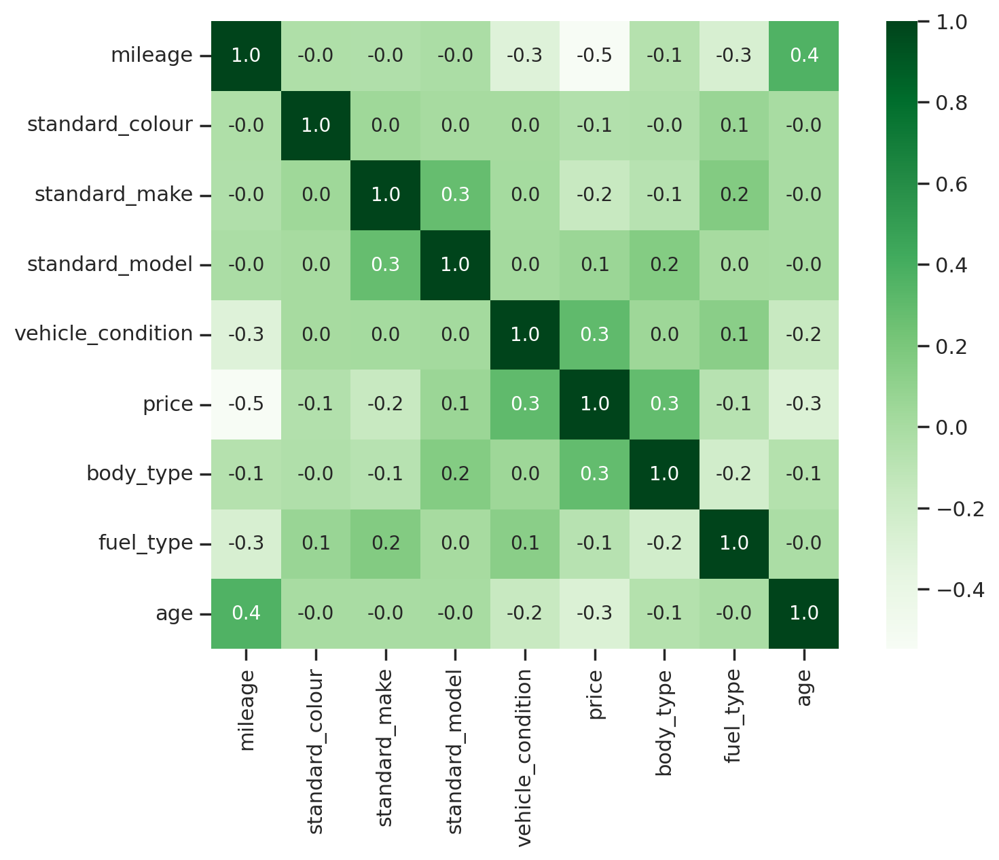

In [80]:
plt.figure(figsize=(9,6))
sns.heatmap(corr, cbar=True, square= True, fmt='.1f', annot=True, annot_kws={'size':10}, cmap='Greens')

Some Dimensionality reduction has already been completed in section 1. To whittle down the number of categories, I utilised a one-hot encoder and a category encoder.

To get the most from both domain knowledge and algorithmic approaches, it is frequently advised to mix manual selection and automated processes. The best predictors can be found and more effectively used in your models by iteratively enhancing the feature set, assessing model performance, and taking multiple feature selection procedures into account.

### Automated Feature Selection (AFS): Univariate

AFS (Univariate Automated Feature Selection) is a machine learning technique that selects the most relevant features from a dataset based on their unique relationship with the target variable. It entails individually analysing each feature and picking the top-k features based on specific criteria.

In [81]:
#import necessory modules for AFS
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.linear_model import ElasticNet
from sklearn.model_selection import cross_val_score

In [82]:
#Create an instance of the SelectKBest class
selector = SelectKBest(f_regression, k=4).fit(X, y)
X_sel = selector.transform(X)

For regression problems, the `f_regression` scoring function is commonly used.

In [83]:
X_sel[0]

array([9.5253e+04, 0.0000e+00, 5.0000e+00, 7.0000e+00])

In [84]:
selector.get_feature_names_out()

array(['mileage', 'vehicle_condition', 'body_type', 'age'], dtype=object)

Here this selector method (get_feature_names_out) printed the main features from the dataset

In [85]:
pd.DataFrame(X_sel, columns=selector.get_feature_names_out()).head()

,mileage,vehicle_condition,body_type,age
0,95253.0,0.0,5.0,7.0
1,21900.0,0.0,5.0,9.0
2,18855.0,0.0,11.0,6.0
3,47000.0,0.0,11.0,6.0
4,88000.0,0.0,11.0,9.0


In [86]:
# could create a pipeline simply to get a pandas DataFrame as output
selector = make_pipeline(
    SelectKBest(f_regression, k=7)
).set_output(transform='pandas').fit(X, y)
X_sel = selector.transform(X)

In [87]:
X_sel.head()

,mileage,standard_make,standard_model,vehicle_condition,body_type,fuel_type,age
0,95253.0,5.0,26.0,0.0,5.0,1.0,7.0
1,21900.0,21.0,579.0,0.0,5.0,5.0,9.0
2,18855.0,38.0,296.0,0.0,11.0,5.0,6.0
3,47000.0,34.0,151.0,0.0,11.0,5.0,6.0
4,88000.0,28.0,241.0,0.0,11.0,1.0,9.0


### Sequential Feature Selection (SFS) (Forward/Backward)

Another widely used strategy in machine learning for feature selection is sequential feature selection (SFS). Based on each feature's specific contribution to the performance of the model, features are either chosen or removed step by step. SFS can be carried out in a forward or a backward direction, each with a different methodology.

### Forward Sequential Feature Selection

The forward sequential feature selection iteratively selects the best feature at each stage based on its contribution to the performance of the model, eventually expanding the feature set.

In [88]:
from sklearn.feature_selection import SequentialFeatureSelector

In [89]:
sfs_forward = SequentialFeatureSelector(
    Ridge(), n_features_to_select=7, direction="forward"
).fit(X, y)

In [90]:
sfs_forward.get_feature_names_out()

array(['mileage', 'standard_colour', 'standard_make', 'standard_model',
       'vehicle_condition', 'body_type', 'fuel_type'], dtype=object)

# 4.[Model Building](#4-Model-Building)

A model is a mathematical or computational representation that can learn from data and make predictions or judgements. The process for building models is known as machine learning.

Model selection: Determine the best method or model architecture based on the nature of the problem and the available data. This decision is influenced by a number of variables, including the kind of problem (linear or nonlinear), the size of the dataset, the presence of labelled data, and the computational resources that are available.


##  4.1 [A Linear Model](#4.1-A-Linear-Model)

Machine learning's core method for modelling the connection between a dependent variable and one or more independent variables is called linear regression. It makes the assumption that there is a linear relationship between the input and output, and it seeks to identify the line that minimises the sum of the squared discrepancies between the predicted and actual values.


#### Pre-Processing and Model Fitting Pipelines

In [91]:
numeric_features = X_train.select_dtypes(exclude='object').columns.tolist()
numeric_transformer = Pipeline(
    steps=[
        ("imputer", SimpleImputer(strategy="median")),
        ("poly_int", PolynomialFeatures(degree=2, include_bias=False)),
        ("scaler", StandardScaler())
    ]
).set_output(transform='pandas')
print(numeric_features)
numeric_transformer

['mileage', 'standard_colour', 'standard_make', 'standard_model', 'vehicle_condition', 'body_type', 'fuel_type', 'age']


Pipeline(steps=[('imputer', SimpleImputer(strategy='median')),
                ('poly_int', PolynomialFeatures(include_bias=False)),
                ('scaler', StandardScaler())])

For the model, I defined a numerical transformer pipeline. The pipeline consists of three steps: imputing missing data using the median, applying polynomial features with a degree of 2, and scaling the features using standardisation.


In [92]:
numeric_transformer.fit_transform(X_train[numeric_features]).head()

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,body_type,fuel_type,age,mileage^2,mileage standard_colour,...,vehicle_condition^2,vehicle_condition body_type,vehicle_condition fuel_type,vehicle_condition age,body_type^2,body_type fuel_type,body_type age,fuel_type^2,fuel_type age,age^2
14223,0.056968,-1.207174,1.176505,-0.889372,-0.258189,-1.560455,0.755056,0.554959,-0.252619,-0.699627,...,-0.258189,-0.237870,-0.245222,-0.258189,-1.117457,-0.759406,-0.233542,0.705703,0.778196,0.001885
4518,-1.209583,-1.207174,0.531955,-0.499910,3.873134,-0.632908,-1.242934,-0.578885,-0.724408,-0.796788,...,3.873134,2.239276,0.625726,3.873134,-0.699319,-1.048144,-0.377435,-1.213874,-0.487986,-0.016542
10252,1.570918,0.813290,0.263392,0.170193,-0.258189,1.222188,-1.242934,0.451882,1.549375,2.189435,...,-0.258189,-0.237870,-0.245222,-0.258189,1.212169,-0.701659,0.719750,-1.213874,-0.287005,-0.000907
9138,-0.030295,1.279551,1.230218,0.714294,-0.258189,-0.632908,0.755056,0.039575,-0.315390,0.741154,...,-0.258189,-0.237870,-0.245222,-0.258189,-0.699319,0.106808,-0.107635,0.705703,0.275743,-0.009841
14532,-0.504758,-1.207174,-1.509121,-1.296016,-0.258189,1.531370,-1.242934,-0.166578,-0.578303,-0.742718,...,-0.258189,-0.237870,-0.245222,-0.258189,1.670130,-0.643911,0.180151,-1.213874,-0.407594,-0.012968


In [93]:
categorical_features = X_train.select_dtypes(include='object').columns.tolist()
categorical_transformer = Pipeline(
    steps=[
        ("imputer", SimpleImputer(strategy="most_frequent")), 
        ("ohe", OneHotEncoder(handle_unknown="ignore", sparse_output=False, drop='if_binary')),
    ]
).set_output(transform='pandas')
print(categorical_features)
categorical_transformer

[]


Pipeline(steps=[('imputer', SimpleImputer(strategy='most_frequent')),
                ('ohe',
                 OneHotEncoder(drop='if_binary', handle_unknown='ignore',
                               sparse_output=False))])

Pipeline for preparing categorical features in a machine learning model using a categorical transformer

In [94]:
preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ],
    remainder='passthrough',
    verbose_feature_names_out=False
).set_output(transform="pandas")

In [95]:
preprocessor.fit_transform(X_train).head()

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,body_type,fuel_type,age,mileage^2,mileage standard_colour,...,vehicle_condition^2,vehicle_condition body_type,vehicle_condition fuel_type,vehicle_condition age,body_type^2,body_type fuel_type,body_type age,fuel_type^2,fuel_type age,age^2
14223,0.056968,-1.207174,1.176505,-0.889372,-0.258189,-1.560455,0.755056,0.554959,-0.252619,-0.699627,...,-0.258189,-0.237870,-0.245222,-0.258189,-1.117457,-0.759406,-0.233542,0.705703,0.778196,0.001885
4518,-1.209583,-1.207174,0.531955,-0.499910,3.873134,-0.632908,-1.242934,-0.578885,-0.724408,-0.796788,...,3.873134,2.239276,0.625726,3.873134,-0.699319,-1.048144,-0.377435,-1.213874,-0.487986,-0.016542
10252,1.570918,0.813290,0.263392,0.170193,-0.258189,1.222188,-1.242934,0.451882,1.549375,2.189435,...,-0.258189,-0.237870,-0.245222,-0.258189,1.212169,-0.701659,0.719750,-1.213874,-0.287005,-0.000907
9138,-0.030295,1.279551,1.230218,0.714294,-0.258189,-0.632908,0.755056,0.039575,-0.315390,0.741154,...,-0.258189,-0.237870,-0.245222,-0.258189,-0.699319,0.106808,-0.107635,0.705703,0.275743,-0.009841
14532,-0.504758,-1.207174,-1.509121,-1.296016,-0.258189,1.531370,-1.242934,-0.166578,-0.578303,-0.742718,...,-0.258189,-0.237870,-0.245222,-0.258189,1.670130,-0.643911,0.180151,-1.213874,-0.407594,-0.012968


In [96]:
lrm = Pipeline(
    steps=[
        ("preprocessor", preprocessor), 
        ("regr", Ridge())
    ]
).set_output(transform="pandas")

In [97]:
lrm.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('poly_int',
                                                                   PolynomialFeatures(include_bias=False)),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['mileage', 'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type', 'fuel_type',
                                                   'age']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('ohe',
                                                                   OneHotEncoder(drop='if_binary',
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False))]),
                                                  [])],
                                   verbose_feature_names_out=False)),
                ('regr', Ridge())])

Linear Model Evaluation

In [98]:
train_data_prediction= lrm.predict(X_train)

In [99]:
# R Squared Error
error_score=metrics.r2_score(y_train,train_data_prediction)
print(" R Squared Error: ",error_score)

 R Squared Error:  0.5945174780954142


R-squared (R2): R2 measures the percentage of the dependent variable's variance that the independent variables can account for. It has a range of 0 to 1, with 1 denoting flawless prediction of the dependent variable by the model. Better model fit is indicated by higher R2 values.

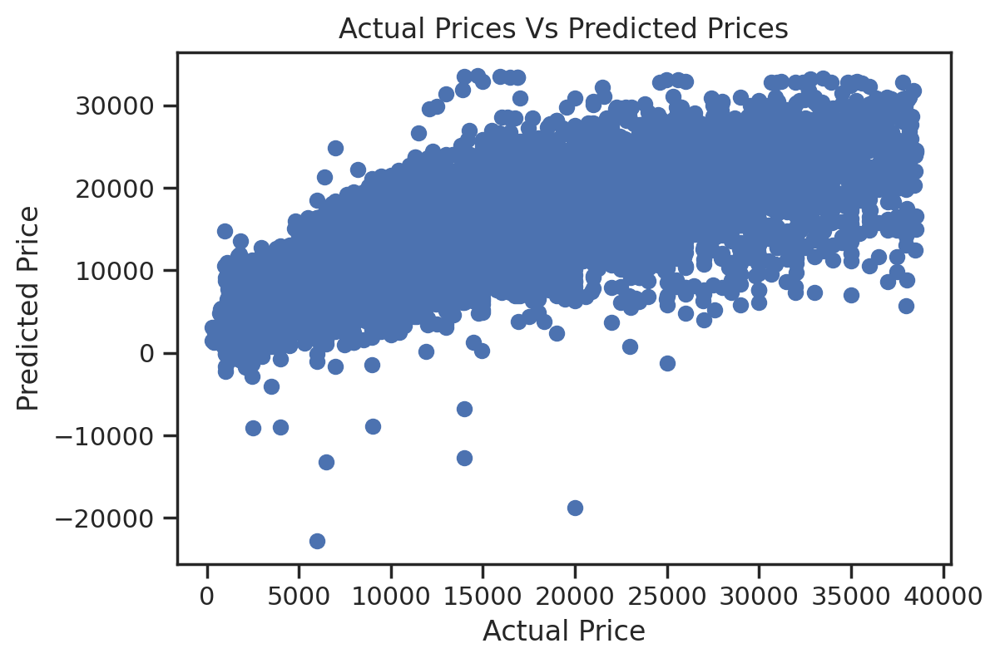

In [100]:
plt.scatter(y_train,train_data_prediction)
plt.xlabel("Actual Price")
plt.ylabel("Predicted Price")
plt.title("Actual Prices Vs Predicted Prices")
plt.show()

In [101]:
mean_absolute_error(y_test, lrm.predict(X_test))

3866.419576678567

In [102]:
mean_absolute_error(y_train, lrm.predict(X_train))

3816.6617877338845

In [103]:
lrm_y_pred= lrm.predict(X_test)
lrm_y_pred.shape

(4571,)

In [104]:
#Training Test Data
# R Squared Error
lrm_slr_score = lrm.score(X_test,y_test)
lrm_slr_score

0.549380806666863

In [105]:
#Training train Data
# R Squared Erro
lrm_slr_score = lrm.score(X_train,y_train)
lrm_slr_score

0.5945174780954142

### Visualizing the actual and predicted prices


In [106]:
test_data_prediction= lrm.predict(X_test)

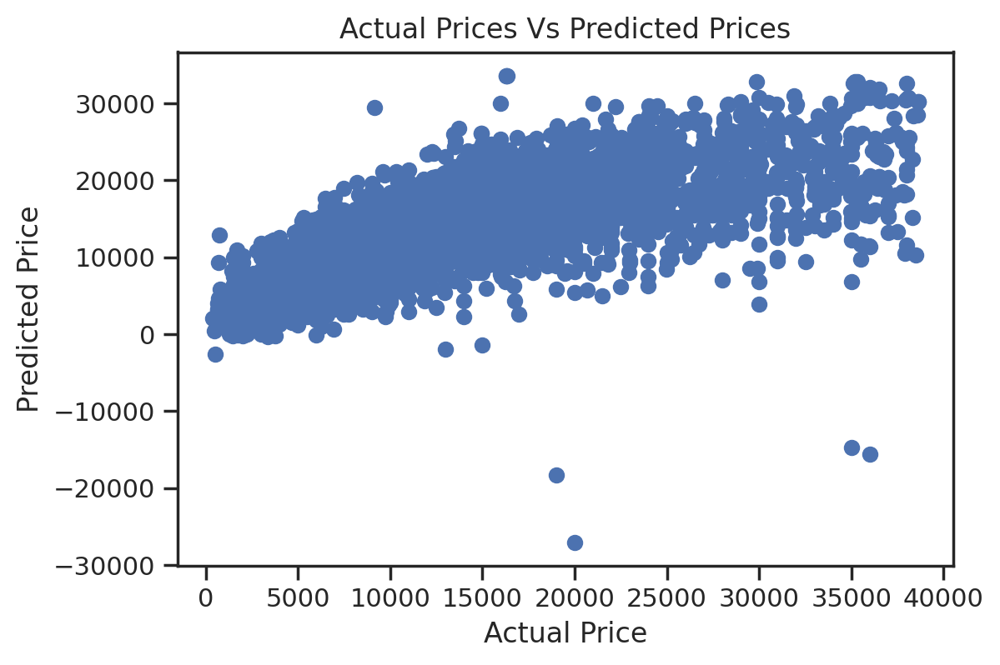

In [107]:
plt.scatter(y_test,test_data_prediction)
plt.xlabel("Actual Price")
plt.ylabel("Predicted Price")
plt.title("Actual Prices Vs Predicted Prices")
plt.show()

## 4.2 [A Random Forest](#4.2-A-Random-Forest)

In [108]:
#importing randomForestRegression
from sklearn.ensemble import RandomForestRegressor

In [109]:
rfr = Pipeline(
    steps=[
        ("preprocessor", preprocessor), 
        ("regr", RandomForestRegressor())
    ]
).set_output(transform="pandas")

In [110]:
rfr.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('poly_int',
                                                                   PolynomialFeatures(include_bias=False)),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['mileage', 'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type', 'fuel_type',
                                                   'age']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('ohe',
                                                                   OneHotEncoder(drop='if_binary',
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False))]),
                                                  [])],
                                   verbose_feature_names_out=False)),
                ('regr', RandomForestRegressor())])

To calculate the mean absolute error, the mean absolute error function generates the two local variables total and count.

In [111]:
mean_absolute_error(y_test, rfr.predict(X_test))

1956.9014945189151

In [112]:
mean_absolute_error(y_train, rfr.predict(X_train))

748.6705589729396

In [113]:
y_test.describe()

count     4571.000000
mean     13572.246992
std       8183.117057
min        390.000000
25%       7495.000000
50%      11995.000000
75%      18292.500000
max      38610.000000
Name: price, dtype: float64

<Axes: xlabel='price'>

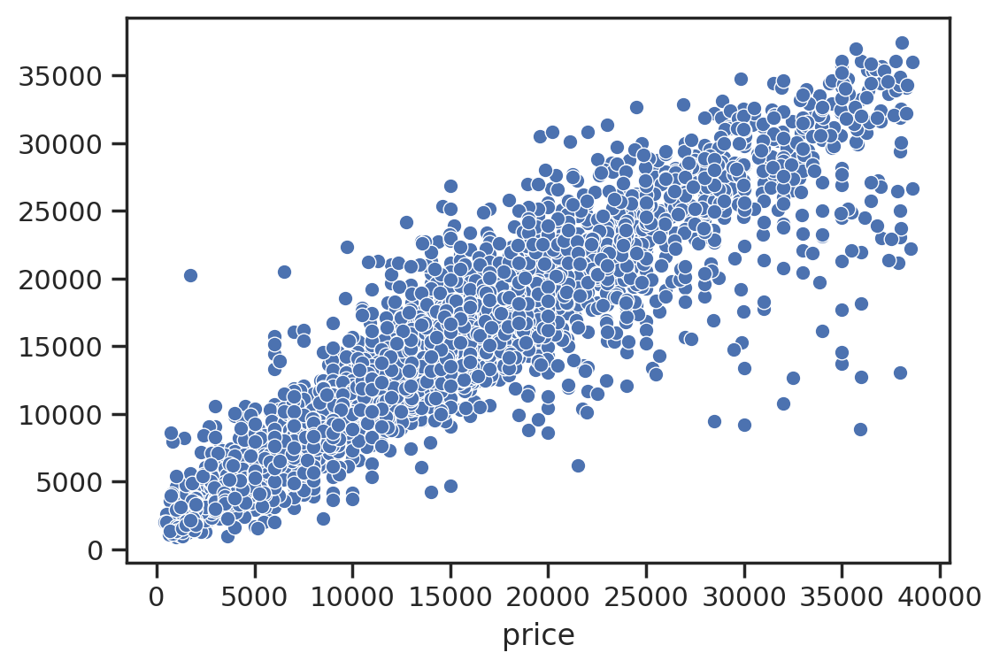

In [114]:
sns.scatterplot(x=y_test, y=rfr.predict(X_test))

In [115]:
rfg_y_pred= rfr.predict(X_test)
rfg_y_pred.shape

(4571,)

In [116]:
rfg_slr_score = rfr.score(X_test,y_test)
rfg_slr_score

0.8611181552356093

In [117]:
rfg_slr_score = rfr.score(X_train,y_train)
rfg_slr_score

0.9800886815320545

<Axes: xlabel='price'>

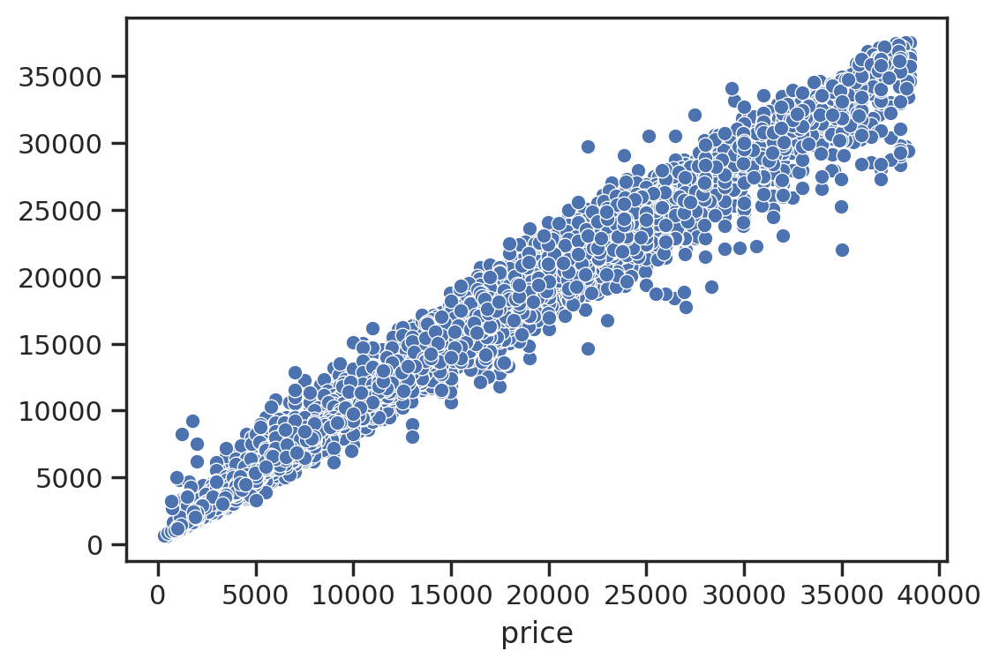

In [118]:
sns.scatterplot(x=y_train, y=rfr.predict(X_train))

## 4.3 [A Boosted Tree](#4.3-A-Boosted-Tree)

A boosted tree model, sometimes referred to as gradient boosting, is an ensemble machine learning technique that combines different decision trees to produce an effective prediction model. It belongs to the category of boosting techniques where weak learners are sequentially added to the model, each focusing on the samples that were previously misclassified or have high residuals. Typically, decision trees are used as weak learners. By adding up all of the weak learners' predictions, the final prediction is obtained.

In [119]:
def create_def_preprocessing_pipe(X):
    preprocessor = ColumnTransformer(
        transformers=[
            ("num", numeric_transformer, numeric_features),
            ("cat", categorical_transformer, categorical_features),
        ],
        remainder='passthrough',
        verbose_feature_names_out=False
    ).set_output(transform="pandas")

    return preprocessor

In [120]:
def create_regr_pipe(est, X):
    regr_pipe1 = Pipeline(
        steps=[
            ("pp", create_def_preprocessing_pipe(X)),
            ("regr", est)
        ]
    ).set_output(transform="pandas")

    return regr_pipe1

#### Model Fitting

In [121]:
gbr = create_regr_pipe(GradientBoostingRegressor(), X_train)

In [122]:
gbr.fit(X_train, y_train)

Pipeline(steps=[('pp',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('poly_int',
                                                                   PolynomialFeatures(include_bias=False)),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['mileage', 'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type', 'fuel_type',
                                                   'age']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('ohe',
                                                                   OneHotEncoder(drop='if_binary',
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False))]),
                                                  [])],
                                   verbose_feature_names_out=False)),
                ('regr', GradientBoostingRegressor())])

In [123]:
scores = cross_val_score(gbr, X_train, y_train, cv=10, scoring='neg_root_mean_squared_error')
scores
scores.mean()*-1, scores.std()

(3792.660845243251, 133.6079937917213)

In [124]:
hgb = create_regr_pipe(HistGradientBoostingRegressor(), X_train)

In [125]:
hgb.fit(X_train, y_train)

Pipeline(steps=[('pp',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('poly_int',
                                                                   PolynomialFeatures(include_bias=False)),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['mileage', 'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type', 'fuel_type',
                                                   'age']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('ohe',
                                                                   OneHotEncoder(drop='if_binary',
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False))]),
                                                  [])],
                                   verbose_feature_names_out=False)),
                ('regr', HistGradientBoostingRegressor())])

In [126]:
scores_hgb = cross_val_score(hgb, X_train, y_train, cv=10, scoring='neg_root_mean_squared_error')
scores_hgb.mean()*-1, scores_hgb.std()

(2882.7564191530305, 87.04205794995222)

<Axes: xlabel='price'>

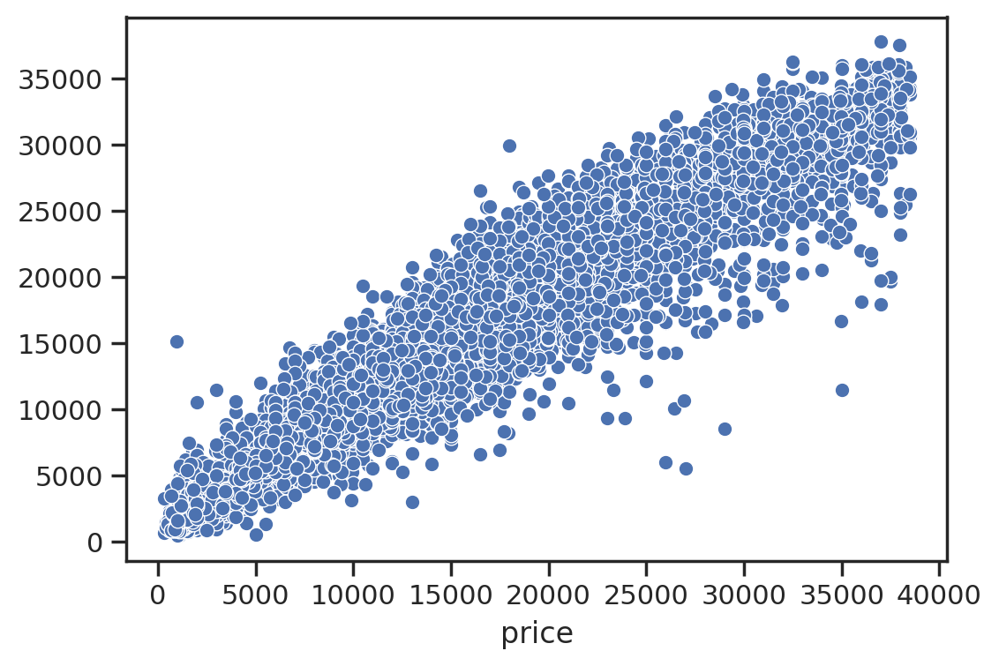

In [172]:
sns.scatterplot(x=y_train, y=hgb.predict(X_train))

<Axes: xlabel='price'>

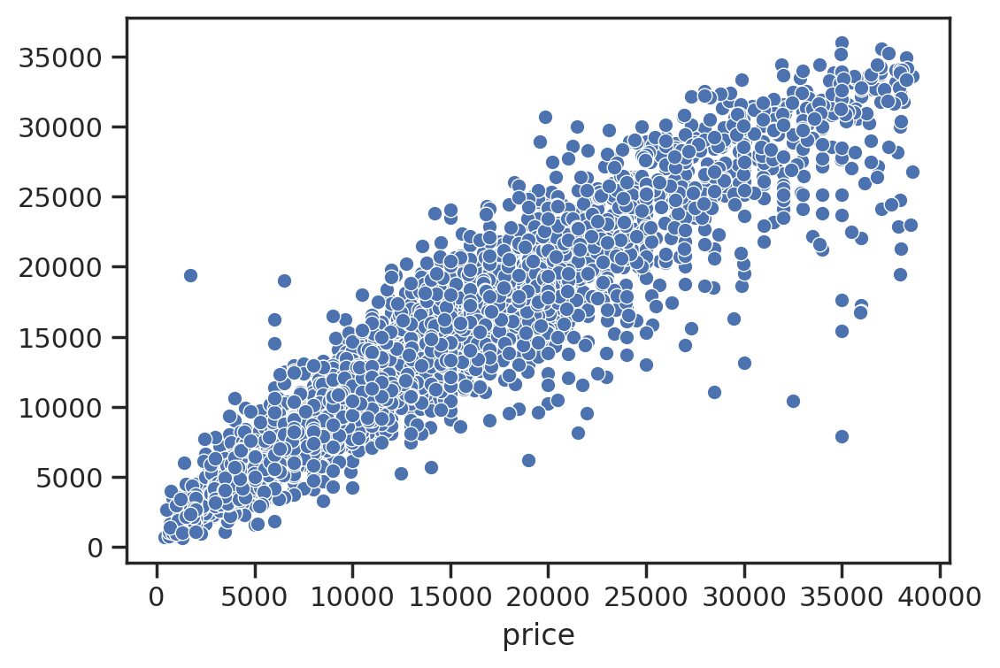

In [173]:
sns.scatterplot(x=y_test, y=hgb.predict(X_test))

## 4.4 [An Averager / Voter / Stacker Ensemble](#4.3-An-Averager-Voter-Stacker-Ensemble)



### Ensembing Voting regressor


In [127]:
ensembled = [ lrm, gbr, rfr, hgb ]

In [128]:
for est in ensembled:
    est.fit(X_train, y_train)

In [129]:
ensemble = VotingRegressor(
    [
        ("lrm", lrm), 
        ("gb", gbr), 
        ("rf", rfr), 
        ("hbg", hgb)
    ]
)
ensemble.fit(X_train, y_train)

VotingRegressor(estimators=[('lrm',
                             Pipeline(steps=[('preprocessor',
                                              ColumnTransformer(remainder='passthrough',
                                                                transformers=[('num',
                                                                               Pipeline(steps=[('imputer',
                                                                                                SimpleImputer(strategy='median')),
                                                                                               ('poly_int',
                                                                                                PolynomialFeatures(include_bias=False)),
                                                                                               ('scaler',
                                                                                                StandardScaler())]),
                                                                               ['mileage',
                                                                                'standard_colour',
                                                                                'standard_make',
                                                                                'standard_model',
                                                                                'vehicle_condit...
                                                                               ['mileage',
                                                                                'standard_colour',
                                                                                'standard_make',
                                                                                'standard_model',
                                                                                'vehicle_condition',
                                                                                'body_type',
                                                                                'fuel_type',
                                                                                'age']),
                                                                              ('cat',
                                                                               Pipeline(steps=[('imputer',
                                                                                                SimpleImputer(strategy='most_frequent')),
                                                                                               ('ohe',
                                                                                                OneHotEncoder(drop='if_binary',
                                                                                                              handle_unknown='ignore',
                                                                                                              sparse_output=False))]),
                                                                               [])],
                                                                verbose_feature_names_out=False)),
                                             ('regr',
                                              HistGradientBoostingRegressor())]))])

In [130]:
all_regr = ensembled + [ ensemble ]

In [131]:
for est in all_regr:
    scores = cross_val_score(est, X_train, y_train, cv=5, scoring='neg_root_mean_squared_error')
    print(scores.mean()*-1, scores.std())

59895.91728387463 109163.00814078219
3784.3761839374447 42.82230481231655
3141.9658773187375 67.37356232814776
2911.7552320739633 60.005793430186195
16681.15623970482 26484.814122207114


### Inspection of Model Output


In [132]:
xt = X.head(20)
pred1 = lrm.predict(xt)
pred2 = gbr.predict(xt)
pred3 = rfr.predict(xt)
pred4 = hgb.predict(xt)
pred5 = ensemble.predict(xt)

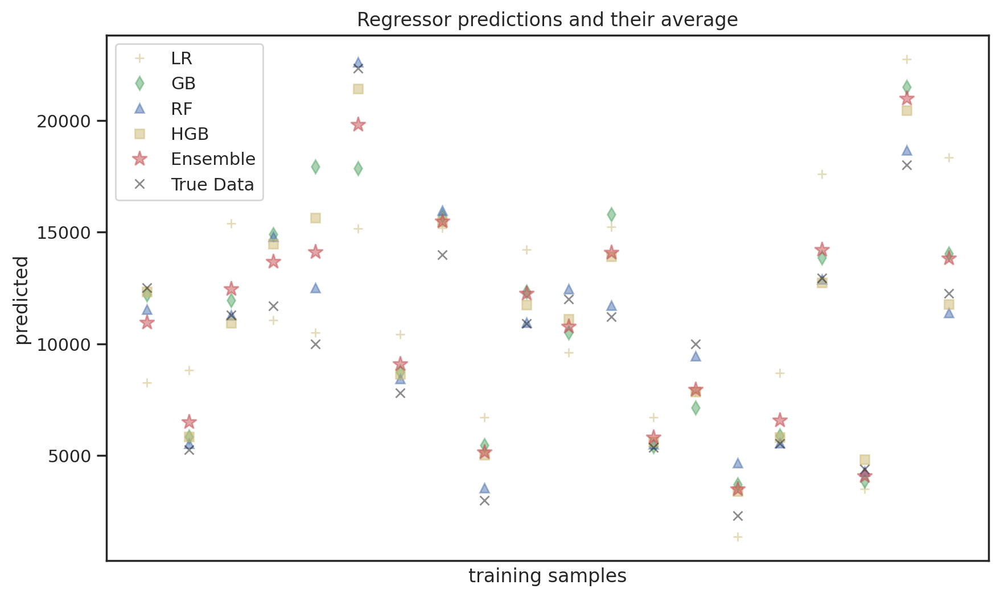

In [133]:
plt.figure(figsize=(10,6))
plt.plot(pred1, "y+", alpha=0.5, label="LR")
plt.plot(pred2, "gd", alpha=0.5, label="GB")
plt.plot(pred3, "b^", alpha=0.5, label="RF")
plt.plot(pred4, "ys", alpha=0.5, label="HGB")
plt.plot(pred5, "r*", alpha=0.5, ms=10, label="Ensemble")
plt.plot(y.head(20), "kx", alpha=0.5, label="True Data")

plt.tick_params(axis="x", which="both", bottom=False, top=False, labelbottom=False)
plt.ylabel("predicted")
plt.xlabel("training samples")
plt.legend(loc="best")
plt.title("Regressor predictions and their average")

plt.show()

In [134]:
instance = X.head(1)
(lrm.predict(instance), gbr.predict(instance), rfr.predict(instance), hgb.predict(instance), ensemble.predict(instance))

(array([8263.41574639]),
 array([12206.87140891]),
 array([11549.89]),
 array([12340.2312045]),
 array([10954.61533623]))

### Grid search with pipelines and ranking

In [135]:
np.linspace(1, 5, 5, dtype='int')

array([1, 2, 3, 4, 5])

In [136]:
param_grid = dict(
    regr__alpha=np.logspace(-3, 3, 7),
)

In [137]:
grid = GridSearchCV(
    lrm, param_grid, return_train_score=True, 
    scoring='neg_root_mean_squared_error'
)

In [138]:
grid.fit(X_train, y_train)

GridSearchCV(estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('num',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('poly_int',
                                                                                          PolynomialFeatures(include_bias=False)),
                                                                                         ('scaler',
                                                                                          StandardScaler())]),
                                                                         ['mileage',
                                                                          'standard_colour',
                                                                          'standard_make',
                                                                          'standard_model',
                                                                          'vehicle_condition',
                                                                          'body_t...
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='most_frequent')),
                                                                                         ('ohe',
                                                                                          OneHotEncoder(drop='if_binary',
                                                                                                        handle_unknown='ignore',
                                                                                                        sparse_output=False))]),
                                                                         [])],
                                                          verbose_feature_names_out=False)),
                                       ('regr', Ridge())]),
             param_grid={'regr__alpha': array([1.e-03, 1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03])},
             return_train_score=True, scoring='neg_root_mean_squared_error')

In [139]:
results = pd.DataFrame(grid.cv_results_)

In [140]:
results[ 
    [ 'param_regr__alpha', 'mean_test_score', 'std_test_score', 
      'mean_train_score', 'std_train_score', 'rank_test_score' ]
].sort_values('rank_test_score').rename(
    columns=dict(
        param_regr__alpha='alpha'
    )
)

,alpha,mean_test_score,std_test_score,mean_train_score,std_train_score,rank_test_score
6,1000.0,-46553.985319,81176.494865,-5887.681954,79.976897,1
0,0.001,-59654.466077,108680.621016,-5249.932544,25.413754,2
1,0.01,-59656.680892,108685.050795,-5249.932569,25.413761,3
2,0.1,-59678.788998,108729.263366,-5249.934966,25.414413,4
3,1.0,-59895.917284,109163.008141,-5250.160091,25.473892,5
4,10.0,-61720.630167,112781.247056,-5263.979626,28.382607,6
5,100.0,-66386.900196,121681.776766,-5469.902915,51.805436,7


# 5.[Model Evaluation and Analysis](#4-Model-Evaluation-and-Analysis)

An key stage in determining the effectiveness and performance of a machine learning model is model evaluation and analysis. In order to get insights from this process, we frequently employ well-known score and loss measures, compare true vs. predicted plots, investigate feature importance, and examine model output space


An key stage in determining the effectiveness and performance of a machine learning model is model evaluation and analysis. In order to get insights from this process, we frequently employ well-known score and loss measures, compare true vs. predicted plots, investigate feature importance, and examine model output space


Linear Model and Random Forest Evaluation already performed in section 4.1 and 4.2 and got score of both models

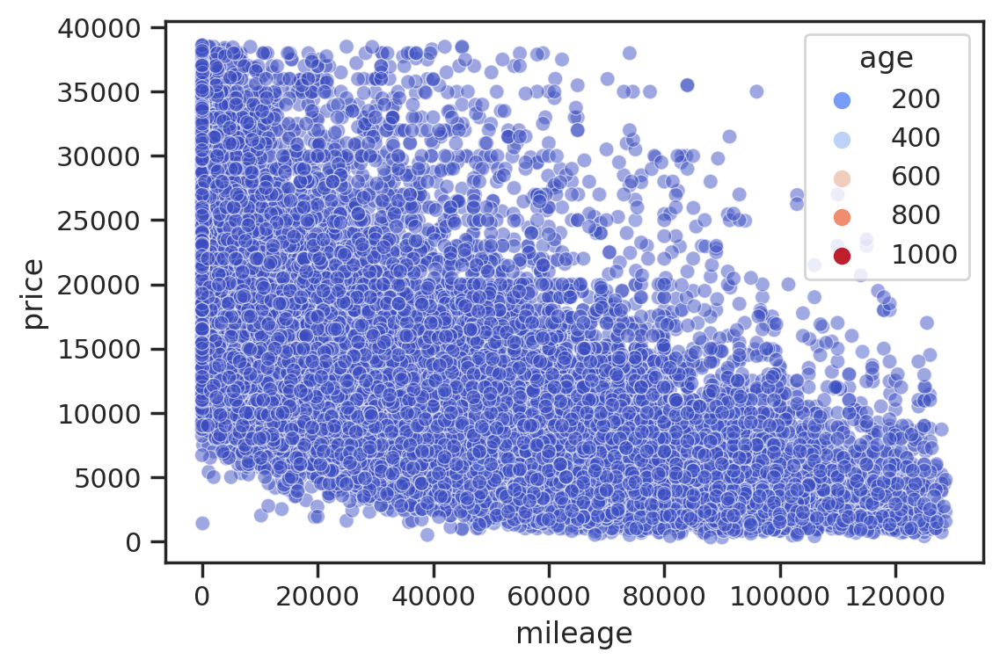

In [141]:
sns.scatterplot(x=adv['mileage'], y=adv['price'], alpha=0.5,hue=adv['age'],  hue_order=['Po', 'Fa', 'TA', 'Gd', 'Ex'],  palette='coolwarm');

In [186]:
## feature importance test
from sklearn.feature_selection import mutual_info_classif

In [187]:
importance = mutual_info_classif(X,y)

In [191]:
feat_importance = pd.Series(importance, adv.columns[0: len(adv.columns)-1])

<Axes: >

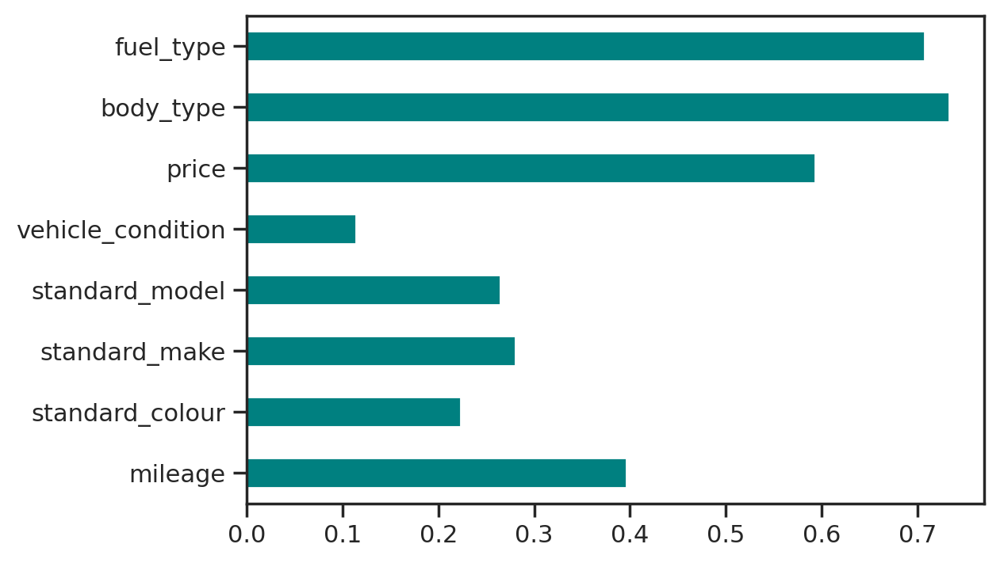

In [189]:
feat_importance.plot(kind='barh', color='teal')

## 5.1 [Overall Performance with Cross-Validation](#4.1-Overall-Performance-with-cross-validation)

In [142]:
scores = cross_val_score(
    rfr, X_train, y_train, cv=10, scoring='neg_root_mean_squared_error'
)*-1
scores.mean(), scores.std()

(3083.829666778655, 117.40561705404949)

### Recursive Feature Elimination (RFE)

A feature selection method frequently used in machine learning is called recursive feature elimination (RFE). By continually training a model and removing the least significant features until only the appropriate amount of features remain, it is an iterative technique that seeks to identify the most crucial elements in a dataset.

We will proceed directly to RFECV, where the best $f$ is determined for you based on cross-validation results.

In [143]:
from sklearn.feature_selection import RFECV

In [144]:
model = RandomForestRegressor()
ref_selector = RFECV(model, step=1, cv=5)

In [145]:
ref_selector.fit(X, y)

RFECV(cv=5, estimator=RandomForestRegressor())

In [146]:
ref_selector.get_feature_names_out()

array(['standard_make', 'standard_model', 'age'], dtype=object)

In [147]:
n_scores = len(ref_selector.cv_results_["mean_test_score"])
n_scores

8

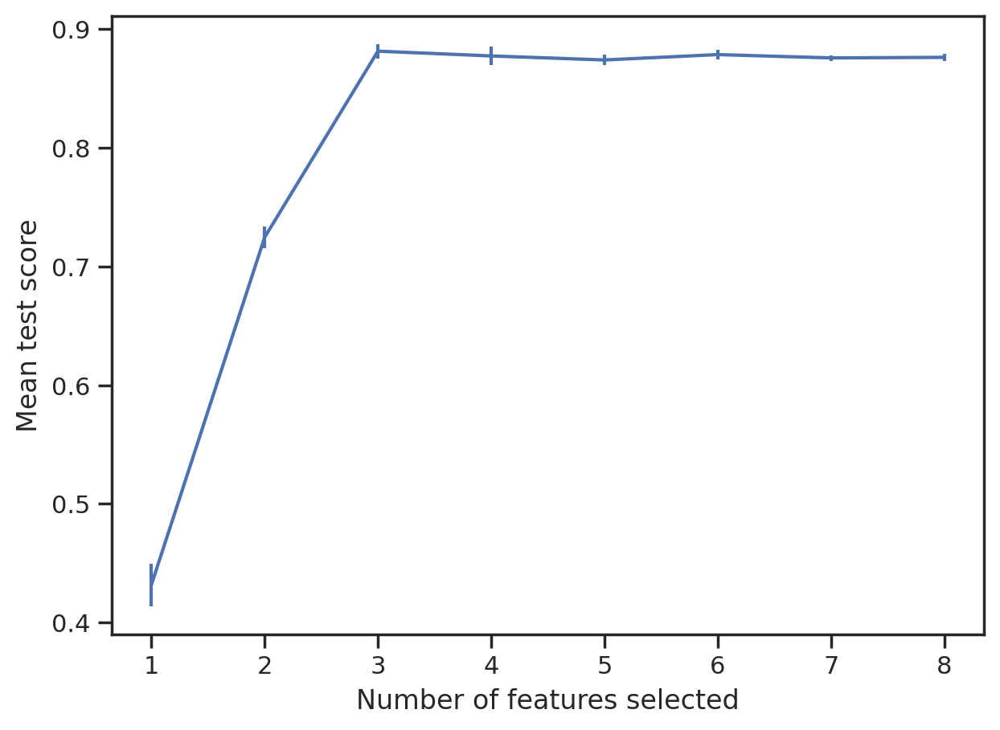

In [148]:
fig, ax = plt.subplots(figsize=(7,5))
ax.errorbar(
    range(1, n_scores+1),
    ref_selector.cv_results_["mean_test_score"],
    yerr=ref_selector.cv_results_["std_test_score"],
)
ax.set_xlabel("Number of features selected")
ax.set_ylabel("Mean test score");

## 5.2 [True vs Predicted Analysis](#4.2-True-vs-Predicted-Analysis)

In [149]:
def plot_true_vs_predicted(
        est, 
        X_train, y_train,
        X_test, y_test,
        ax=None,
        train_style_kws={},
        test_style_kws={}
    ):
    if ax is None:
        fig, ax = plt.subplots()
    y_pred_train = est.predict(X_train)
    y_pred_test = est.predict(X_test)
    ax.plot(y_train, y_pred_train, '.', label='train', **train_style_kws)
    ax.plot(y_test, y_pred_test, '.', label='test', **test_style_kws)
    ax.set_xlabel('True Target')
    ax.set_ylabel('Predicted Target')
    # the diagnonal line for the idealised space of predictions
    ax.plot(
        [0, 1], [0, 1], transform=ax.transAxes, 
        color='gray', linestyle=':', alpha=0.3
    )
    ax.legend()

    return ax

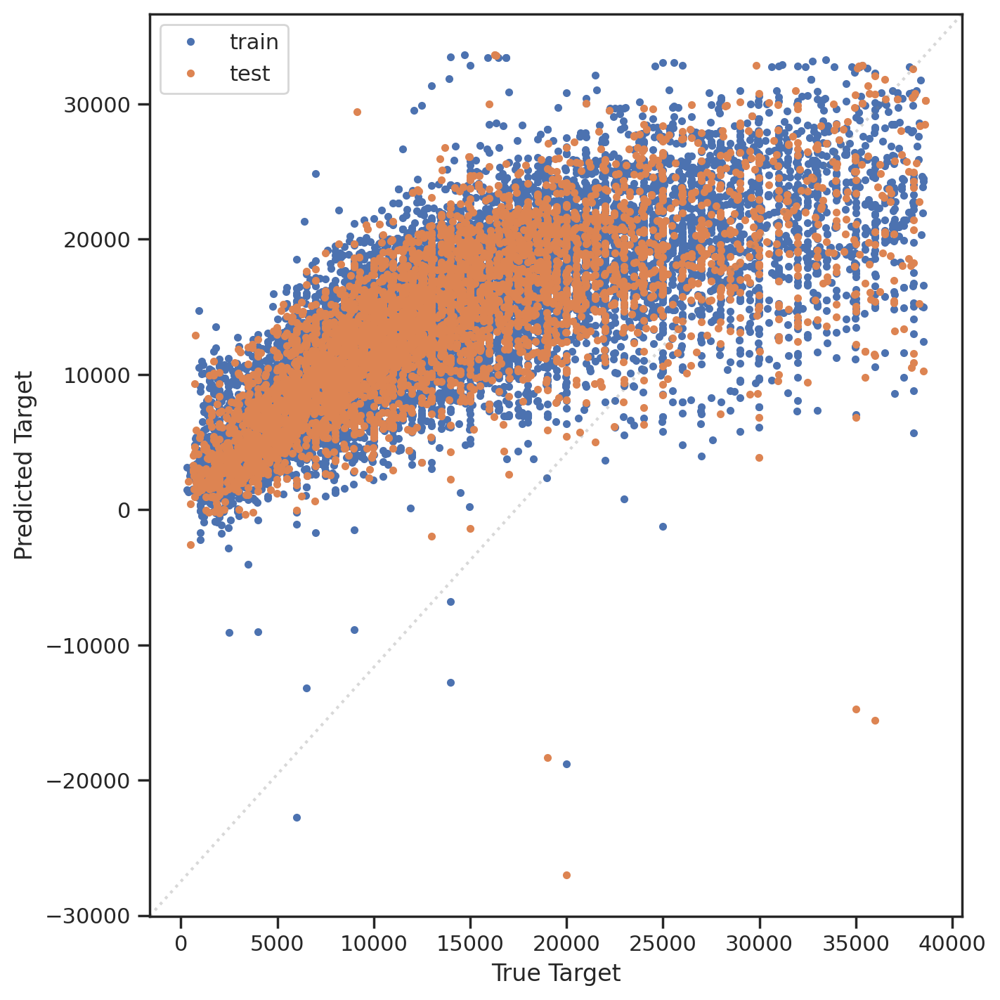

In [150]:
fig, ax = plt.subplots(figsize=(7,7), constrained_layout=True)
plot_true_vs_predicted(
    lrm,
    X_train, y_train,
    X_test, y_test, 
    ax=ax
);

##  5.3 [Global and Local Explanations with SHAP](#4.3-Global-and-Local-Explanations-with-SHAP)   

A technique called SHAP (SHapley Additive exPlanations) is used to justify the predictions made by machine learning models. By giving input characteristics relevance values that reflect their contribution to the model's output, it offers both global and local explanations.

SHAP provides a common framework for analysing the predictions of different machine learning models, such as tree-based models, linear models, neural networks, and more. This helps with model knowledge, debugging, and trust-building by providing a consistent approach to comprehend feature importance and individual feature contributions.


In [151]:
X_pp = rfr['preprocessor'].transform(X_test)

In [152]:
X100 = shap.utils.sample(X_pp, 100) # 100 instances for use as the background distribution

In [153]:
explainer = shap.Explainer(lrm['regr'].predict, X100)
shap_values = explainer(X_pp)

Permutation explainer: 4572it [02:50, 26.09it/s]                          


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


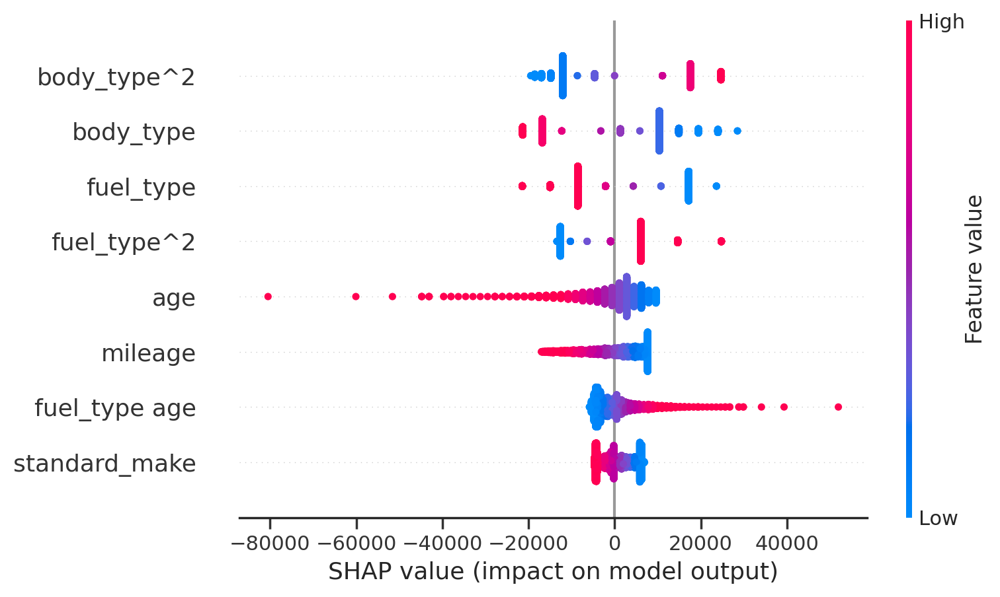

In [154]:
shap.summary_plot(shap_values, X_pp, max_display=8)

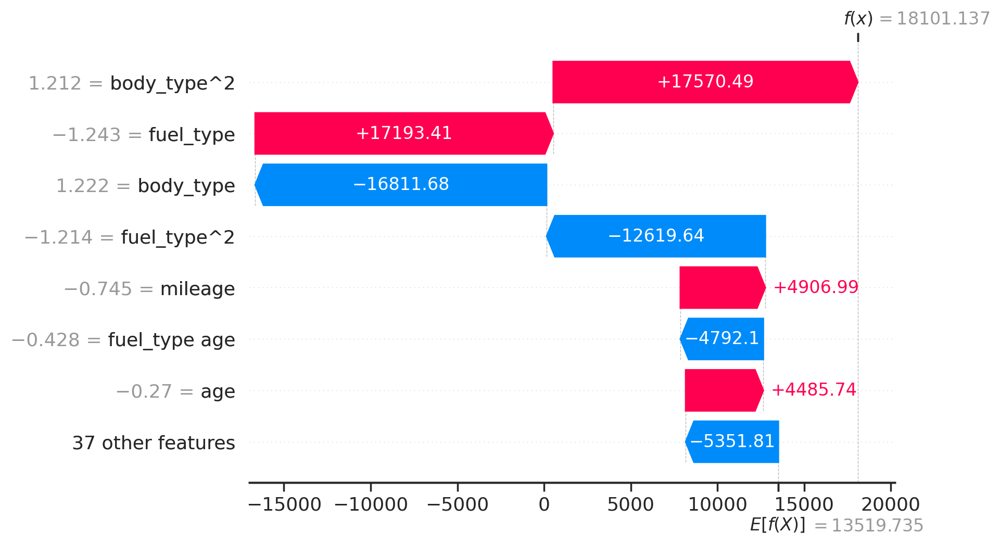

In [182]:
sample_ind = 20
shap.plots.waterfall(shap_values[sample_ind], max_display=8)

## 5.4 [Partial Dependancy Plots](#4.3-Partial-Dependancy-Plots)

#### Individual Conditional Expectation (ICE)

In [155]:
X['body_type'].min(), X['body_type'].max()

(0.0, 13.0)

In [156]:
X['mileage'].min(), X['mileage'].max()

(0.0, 128706.0)

In [157]:
X['age'].min(), X['age'].max()

(2, 1024)

In [158]:
temp_synth_data = np.linspace(X['body_type'].min(), X['body_type'].max(), 100)
temp_synth_data[:5], temp_synth_data[-5:]

(array([0.        , 0.13131313, 0.26262626, 0.39393939, 0.52525253]),
 array([12.47474747, 12.60606061, 12.73737374, 12.86868687, 13.        ]))

Let us pick an random observation, from which we will produce synthetic ones by varying temp across its range.

In [159]:
ex_instance = X.sample(1, random_state=42).drop(columns='age')
ex_instance

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,body_type,fuel_type
15815,600.0,14.0,35.0,69.0,0,5.0,1.0


In [160]:
temp_synth_df = pd.DataFrame(temp_synth_data, columns=['age'])
temp_synth_df.head()

,age
0,0.000000
1,0.131313
2,0.262626
3,0.393939
4,0.525253


In [161]:
synth_df = ex_instance.merge(temp_synth_df, how='cross')
print(synth_df.shape)
synth_df

(100, 8)


,mileage,standard_colour,standard_make,standard_model,vehicle_condition,body_type,fuel_type,age
0,600.0,14.0,35.0,69.0,0,5.0,1.0,0.000000
1,600.0,14.0,35.0,69.0,0,5.0,1.0,0.131313
2,600.0,14.0,35.0,69.0,0,5.0,1.0,0.262626
3,600.0,14.0,35.0,69.0,0,5.0,1.0,0.393939
4,600.0,14.0,35.0,69.0,0,5.0,1.0,0.525253
...,...,...,...,...,...,...,...,...
95,600.0,14.0,35.0,69.0,0,5.0,1.0,12.474747
96,600.0,14.0,35.0,69.0,0,5.0,1.0,12.606061
97,600.0,14.0,35.0,69.0,0,5.0,1.0,12.737374
98,600.0,14.0,35.0,69.0,0,5.0,1.0,12.868687


In [162]:
pred = lrm.predict(synth_df)
pred[:5], pred[-5:]

(array([25731.67746881, 25524.51528835, 25317.36531348, 25110.22754422,
        24903.10198054]),
 array([6105.76831585, 5899.76566711, 5693.77522397, 5487.79698642,
        5281.83095447]))

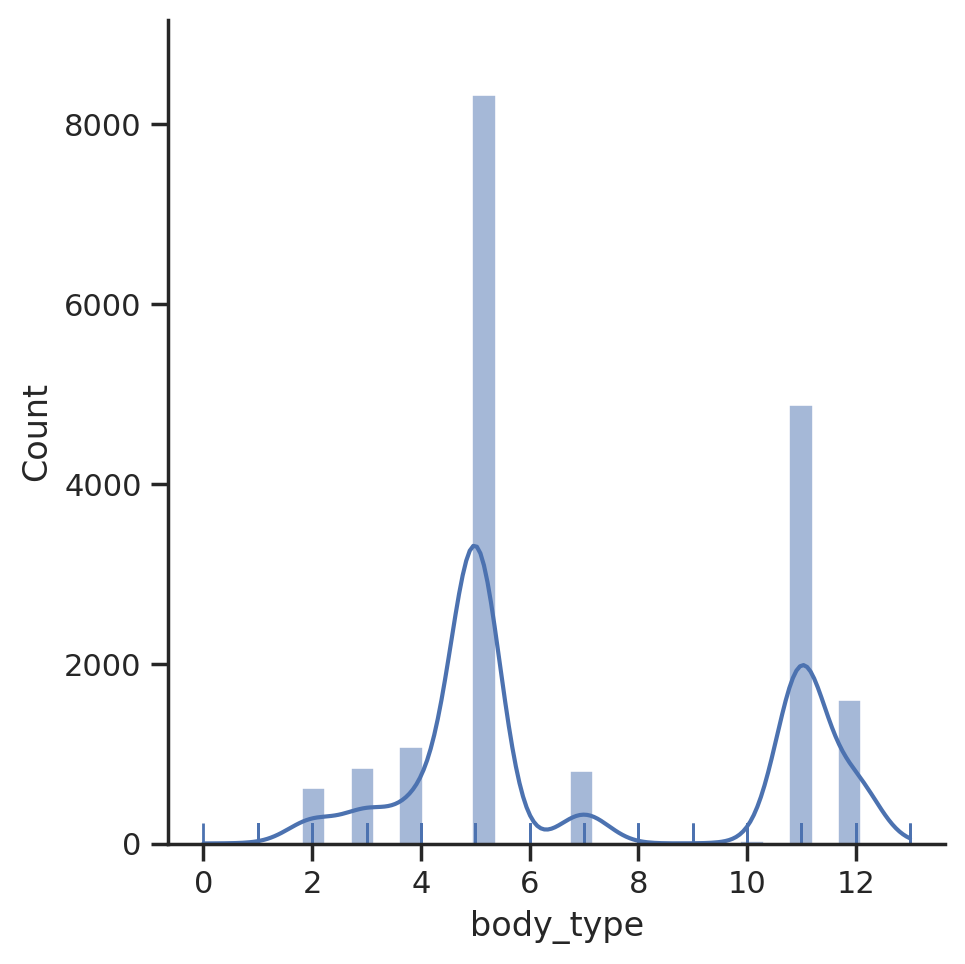

In [163]:
sns.displot(X['body_type'], kde=True, rug=True);

Put simply, for a feature of interest (e.g., temp), a PDP represents the average of all ICEs.

### Partial Dependency Plot (PDP)

In [164]:
from sklearn.inspection import PartialDependenceDisplay

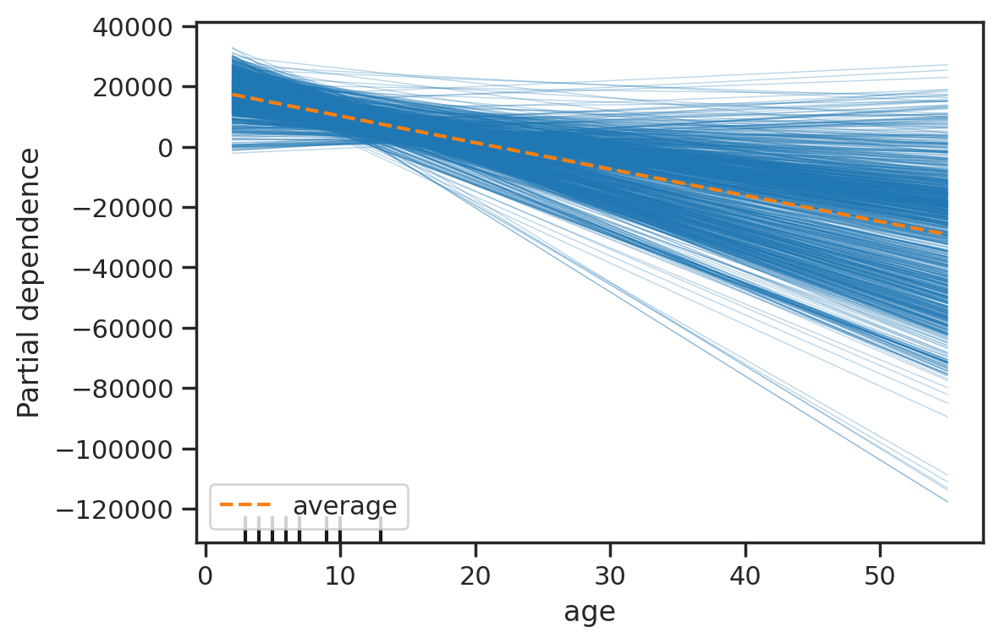

In [165]:
PartialDependenceDisplay.from_estimator(
    lrm, X_test, features=['age'], kind='both'
);

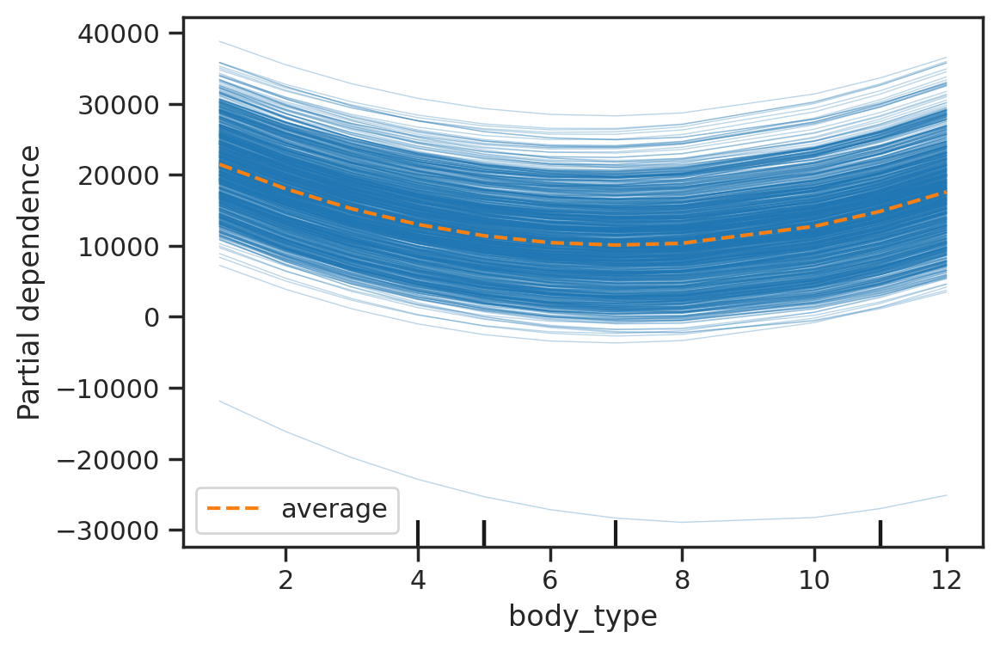

In [166]:
PartialDependenceDisplay.from_estimator(
    lrm, X_test, features=['body_type'], kind='both'
);

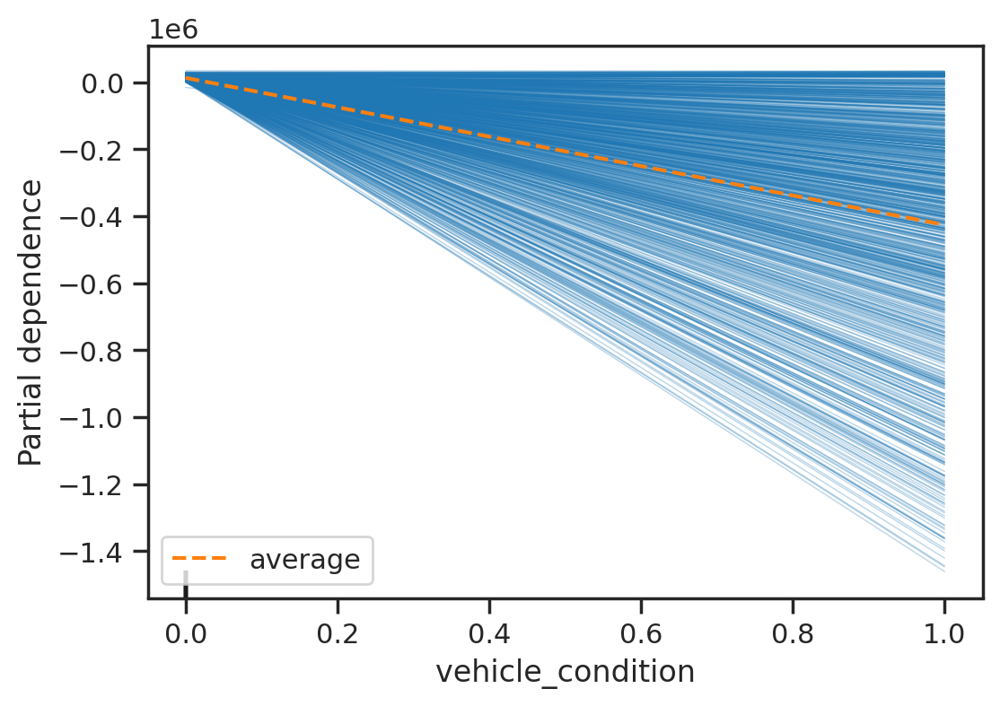

In [167]:
PartialDependenceDisplay.from_estimator(
    lrm, X_test, features=['vehicle_condition'], kind='both'
);

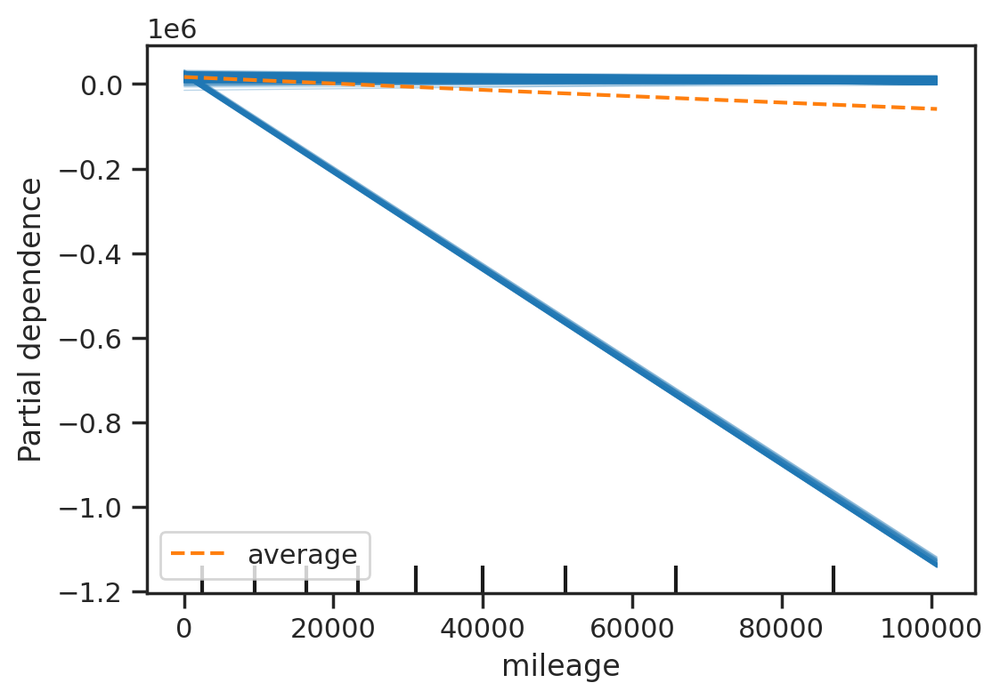

In [168]:
PartialDependenceDisplay.from_estimator(
    lrm, X_test, features=['mileage'], kind='both'
);

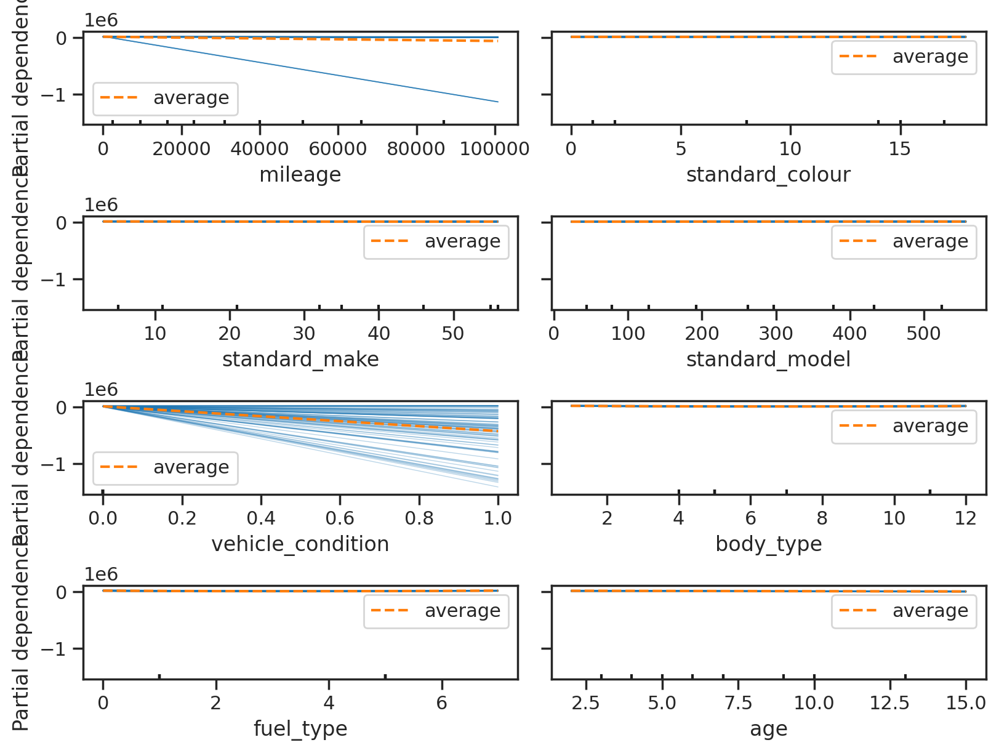

In [169]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)
PartialDependenceDisplay.from_estimator(
    lrm, X_test, features=X_test.select_dtypes(exclude='object').columns,
    kind='both',
    subsample=100, grid_resolution=30, n_jobs=2, random_state=0,
    ax=ax, n_cols=2
);

A 2D one gives us the possibility of analysis feature interactions (just the PDP curve; not feasible to show ICEs as well).

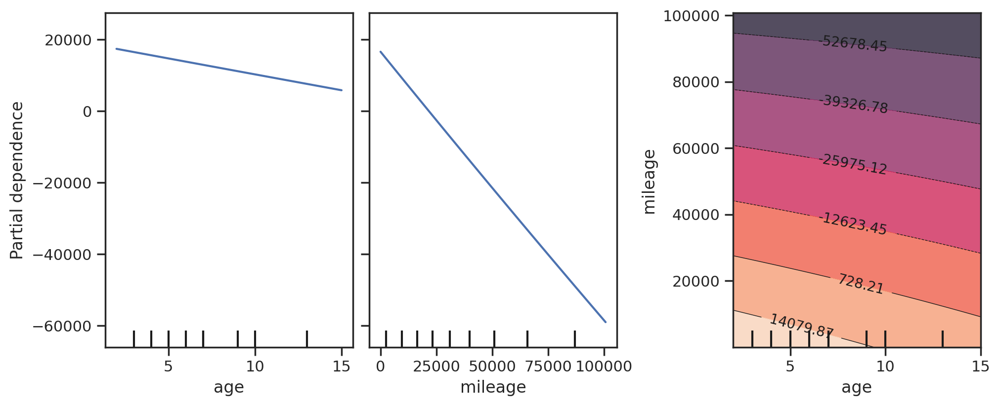

In [170]:
fig, ax = plt.subplots(figsize=(10,4), constrained_layout=True)
PartialDependenceDisplay.from_estimator(
    lrm, X_test, 
    features=["age", "mileage", ("age", "mileage")],
    kind='average', 
    ax=ax, n_cols=3,
    subsample=50, grid_resolution=30, n_jobs=2, random_state=0,
);

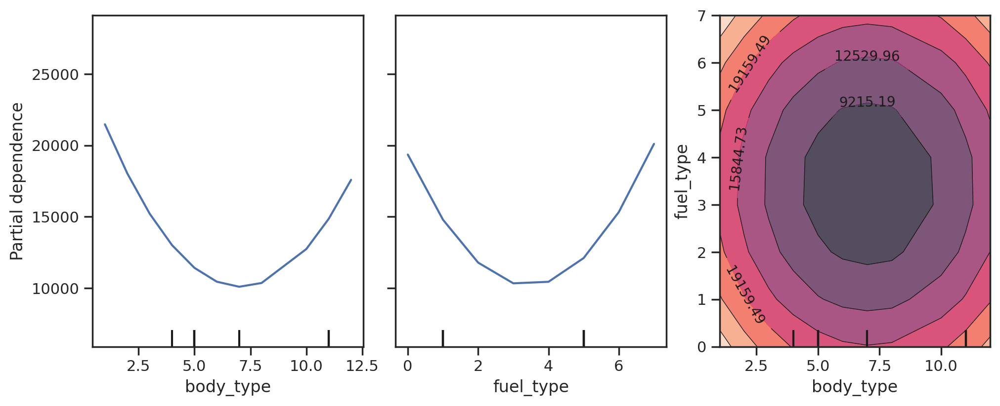

In [171]:
fig, ax = plt.subplots(figsize=(10,4), constrained_layout=True)
PartialDependenceDisplay.from_estimator(
    lrm, X_test, 
    features=["body_type", "fuel_type", ("body_type", "fuel_type")],
    kind='average', 
    ax=ax, n_cols=3,
    subsample=50, grid_resolution=30, n_jobs=2, random_state=0,
);